# Livrable 3 : 

## PARTIE 1 : Modélisation

## Modélisation Formelle

### Description du problème
Le problème consiste à optimiser la distribution et la livraison de colis en utilisant un nombre minimal de camions et en trouvant des chemins optimaux pour chaque camion. Le graphe représente les routes entre les différents nœuds (points de livraison), avec des poids représentant les distances entre les nœuds.

### Variables de décision
- Nœuds : points de livraison.
- Arêtes : routes entre les points de livraison avec des poids représentant les distances.
- Volumes des colis : volume de chaque colis à livrer.

### Contraintes
- Chaque camion a une capacité de volume maximale.
- Tous les colis doivent être livrés en un minimum de trajets.

### Fonctions objectifs
- Minimiser le nombre de camions utilisés.
- Minimiser le poids total des chemins empruntés par chaque camion.

## Méthode de Résolution

### Métaheuristique choisie : Recuit Simulé
- **Voisinage** : Les voisins sont générés en permutant deux points de passage (destinations) dans la route actuelle.
- **Opérations de croisement** : Non applicable.
- **Sélection** : Une nouvelle solution est acceptée si elle améliore la solution actuelle ou avec une probabilité dépendant de la température pour explorer de nouvelles solutions.
- **Mutation** : Permutation aléatoire de deux points de passage pour générer une nouvelle solution.

## PARTIE 2 : Implémentation

#### Définition des fonction, variables + import des bibliothèques

In [1]:
import networkx as nx
import matplotlib.pyplot as plt
import random
import numpy as np
import time
import tracemalloc
from itertools import combinations
import concurrent.futures

# Fonction pour générer un graphe connexe pondéré
def generate_weighted_connected_graph(n):
    G = nx.Graph()
    G.add_nodes_from(range(n))
    for i in range(n - 1):
        weight = random.randint(1, 10)
        G.add_edge(i, i + 1, weight=weight)
    additional_edges = n * 2
    while G.number_of_edges() < additional_edges:
        u = random.randint(0, n - 1)
        v = random.randint(0, n - 1)
        if u != v and not G.has_edge(u, v):
            weight = random.randint(1, 10)
            G.add_edge(u, v, weight=weight)
    return G

# Fonction pour dessiner le graphe pondéré
def draw_weighted_graph(G, paths=None):
    pos = nx.spring_layout(G)
    weights = nx.get_edge_attributes(G, 'weight')
    nx.draw(G, pos, with_labels=True, node_color='lightblue', node_size=500, font_weight='bold')
    nx.draw_networkx_edge_labels(G, pos, edge_labels=weights)
    if paths:
        for path in paths:
            path_edges = [(path[i], path[i + 1]) for i in range(len(path) - 1)]
            nx.draw_networkx_edges(G, pos, edgelist=path_edges, edge_color='r', width=2)
    plt.show()

# Fonction pour calculer le poids total d'un chemin
def calculate_path_weight(G, path, path_lengths):
    total_weight = 0
    for i in range(len(path) - 1):
        total_weight += path_lengths[path[i]][path[i + 1]]
    return total_weight

# Exemple de 2-opt swap
def two_opt_swap(route, i, k):
    new_route = route[:i] + route[i:k+1][::-1] + route[k+1:]
    return new_route

# Fonction pour trouver un chemin optimal en utilisant le recuit simulé
def simulated_annealing(G, initial_points, max_iterations, path_lengths, reset_threshold=100):
    def get_full_path(G, points):
        full_path = []
        for i in range(len(points) - 1):
            full_path.extend(all_paths[points[i]][points[i + 1]][:-1])
        full_path.append(points[-1])
        return full_path

    current_points = initial_points
    current_path = get_full_path(G, current_points)
    current_weight = calculate_path_weight(G, current_path, path_lengths)
    best_path = current_path
    best_weight = current_weight
    T = 10.0  # Température initiale
    T_min = 0.1
    alpha = 0.9995  # Refroidissement

    iteration_data = []

    no_improvement_count = 0

    for iteration in range(max_iterations):
        if T <= T_min:
            break

        i, j = sorted(random.sample(range(1, len(current_points) - 1), 2))
        new_points = two_opt_swap(current_points, i, j)
        new_path = get_full_path(G, new_points)
        new_weight = calculate_path_weight(G, new_path, path_lengths)

        if new_weight < current_weight or random.uniform(0, 1) < np.exp((current_weight - new_weight) / T):
            current_points = new_points
            current_path = new_path
            current_weight = new_weight
            no_improvement_count = 0  # Reset counter on improvement
            if current_weight < best_weight:
                best_path = current_path
                best_weight = current_weight
        else:
            no_improvement_count += 1

        if no_improvement_count >= reset_threshold:
            T = 10.0  # Reset temperature
            no_improvement_count = 0  # Reset the counter
            print(f"Resetting temperature at iteration {iteration}")

        T *= alpha
        iteration_data.append((iteration, current_weight, best_weight))

    return best_path, best_weight, iteration_data

# Fonction pour résoudre le problème de sac à dos pour déterminer le nombre minimal de camions
def knapsack(volumes, truck_capacity):
    n = len(volumes)
    dp = [[0] * (truck_capacity + 1) for _ in range(n + 1)]
    for i in range(1, n + 1):
        for w in range(truck_capacity + 1):
            if volumes[i - 1] <= w:
                dp[i][w] = max(dp[i - 1][w], dp[i - 1][w - volumes[i - 1]] + volumes[i - 1])
            else:
                dp[i][w] = dp[i - 1][w]
    result = []
    w = truck_capacity
    for i in range(n, 0, -1):
        if dp[i][w] != dp[i - 1][w]:
            result.append(i - 1)
            w -= volumes[i - 1]
    return result

# Fonction pour distribuer les colis dans les camions
def distribute_packages(volumes, truck_capacity):
    remaining_packages = volumes.copy()
    all_trucks = []
    while remaining_packages:
        truck = knapsack(remaining_packages, truck_capacity)
        truck_volumes = [remaining_packages[i] for i in truck]
        all_trucks.append(truck_volumes)
        remaining_packages = [vol for i, vol in enumerate(remaining_packages) if i not in truck]
    return all_trucks

# Fonction pour optimiser les chemins de manière parallèle
def optimize_path(points):
    tracemalloc.start()
    start_time = time.time()
    optimal_path, total_weight, iteration_data = simulated_annealing(G, [0] + points + [0], max_iterations, path_lengths)
    exec_time = time.time() - start_time
    mem_usage = tracemalloc.get_traced_memory()[1] / 1024  # Convert to KB
    tracemalloc.stop()
    return optimal_path, total_weight, iteration_data, exec_time, mem_usage

#### Demande à l'utilisateur de chosir une taille de matrice, donc un nombre de ville. Ensuite, génère le graphe pondéré et connexe. 
#### Un Pré-Calcul des chemins par Dijkstra est effectué pour gagner en performance avant de calculer réellement les plus cours chemins. 

In [2]:
# Paramètres du problème
n = int(input("Entrez la taille de la matrice (nombre de nœuds) : "))

# Générer le graphe
G = generate_weighted_connected_graph(n)

# Pré-calculer les chemins de Dijkstra pour toutes les paires de nœuds
all_paths = dict(nx.all_pairs_dijkstra_path(G, weight='weight'))

# Calculer les plus courts chemins entre toutes les paires de nœuds
path_lengths = dict(nx.all_pairs_dijkstra_path_length(G, weight='weight'))

Entrez la taille de la matrice (nombre de nœuds) :  200


#### Demande à l'utilisateur de chosir un nombre de colis ainsi que le nombre d'itération pour le recuit simulé. 
#### On définis aussi ici la taille du camion en m3. On affiche ensuite les infos sur les colis crées. 

In [3]:
num_packages = int(input("Entrez le nombre de colis : "))
truck_capacity = 20  # Capacité des camions en m3
max_iterations = int(input("Entrez le nombre d'itérations pour le recuit simulé : "))

# Générer les colis et leurs volumes
packages = [(random.randint(0, n - 1), round(random.uniform(0.5, 3), 1)) for _ in range(num_packages)]
package_volumes = [round(vol, 1) for _, vol in packages]

Entrez le nombre de colis :  30
Entrez le nombre d'itérations pour le recuit simulé :  100


#### Ajustement des volumes des colis pour la fonction du sac à dos puis distribution des colis dans les camions grace à la fonction distribute_packages, puis on construit la liste de passage obligtatoire pour tous les camions.  

In [4]:
# Ajuster les volumes pour le problème de sac à dos
scaled_volumes = [int(vol * 10) for vol in package_volumes]
scaled_capacity = int(truck_capacity * 10)

# Distribuer les colis dans les camions
trucks = distribute_packages(scaled_volumes, scaled_capacity)
truck_assignments = [[packages[i][0] for i in truck] for truck in trucks]

#### On execute la fonction optimize_path en parallèle pour chaque camion.

#### Création d'un pool de threads : On utilise ThreadPoolExecutor pour créer un pool de threads qui permettra d'exécuter plusieurs instances de optimize_path simultanément.

#### Soumission des tâches au pool : Pour chaque ensemble de points de passage (points) de chaque camion, on soumet une tâche à exécuter en parallèle au pool de threads via executor.submit(optimize_path, points).

#### Récupération des résultats : Une fois que toutes les tâches ont été soumises, on récupère les résultats de chaque tâche avec f.result() où f est le future associé à la tâche. Ces résultats sont stockés dans une liste appelée results.

In [5]:
# Exécuter le recuit simulé pour chaque camion en parallèle
results = []
with concurrent.futures.ThreadPoolExecutor() as executor:
    futures = [executor.submit(optimize_path, points) for points in truck_assignments]
    results = [f.result() for f in futures]

#### Extraction des résultats : On extraie ensuite les différents résultats de chaque tâche parallèle dans des listes distinctes : all_paths, total_weights, all_iterations_data, times et memory_usages. Chaque élément de ces listes correspond aux résultats pour un camion spécifique. 
#### Mise en forme des résultats pour l'utilisateur. 

In [6]:
# Extraire les résultats
all_paths, total_weights, all_iterations_data, times, memory_usages = zip(*results)

for i, (optimal_path, total_weight, iteration_data, exec_time, mem_usage) in enumerate(results):
    print(f"\nPoints de passage pour le camion {i + 1} : {truck_assignments[i]}")
    print(f"Chemin optimal pour le camion {i + 1} : {optimal_path}")
    print(f"Poids total du chemin pour le camion {i + 1} : {total_weight}")
    print(f"Temps de calcul : {exec_time:.4f} secondes")
    print(f"Utilisation de la mémoire : {mem_usage:.2f} Ko")


Points de passage pour le camion 1 : [91, 52, 128, 119, 158, 11, 67, 91, 119, 119, 52]
Chemin optimal pour le camion 1 : [0, 166, 167, 51, 52, 127, 128, 27, 28, 120, 119, 104, 103, 102, 169, 125, 73, 108, 107, 158, 107, 108, 110, 142, 67, 66, 89, 90, 91, 10, 11, 10, 91, 55, 54, 53, 172, 166, 0]
Poids total du chemin pour le camion 1 : 119
Temps de calcul : 0.0032 secondes
Utilisation de la mémoire : 5.88 Ko

Points de passage pour le camion 2 : [1, 154, 36, 158, 132, 14, 105, 105, 1, 105, 115]
Chemin optimal pour le camion 2 : [0, 166, 172, 133, 132, 133, 115, 6, 155, 154, 155, 36, 155, 156, 157, 158, 107, 108, 73, 105, 73, 125, 124, 14, 13, 6, 75, 0, 1, 0]
Poids total du chemin pour le camion 2 : 128
Temps de calcul : 0.0032 secondes
Utilisation de la mémoire : 8.63 Ko

Points de passage pour le camion 3 : [30, 54, 54, 63, 105, 52, 132, 105]
Chemin optimal pour le camion 3 : [0, 166, 167, 51, 52, 51, 31, 30, 63, 30, 31, 53, 172, 133, 132, 133, 172, 53, 54, 55, 102, 103, 104, 105, 73,

#### Affichage des différent graphes, métriques etc... 

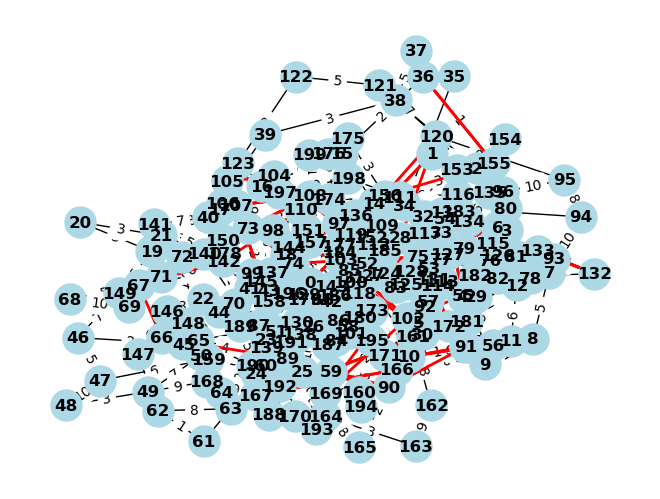

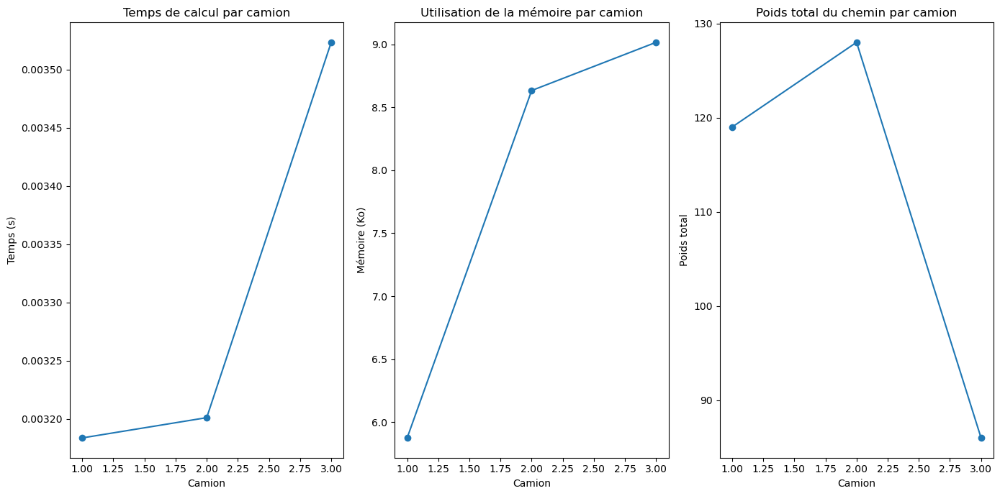

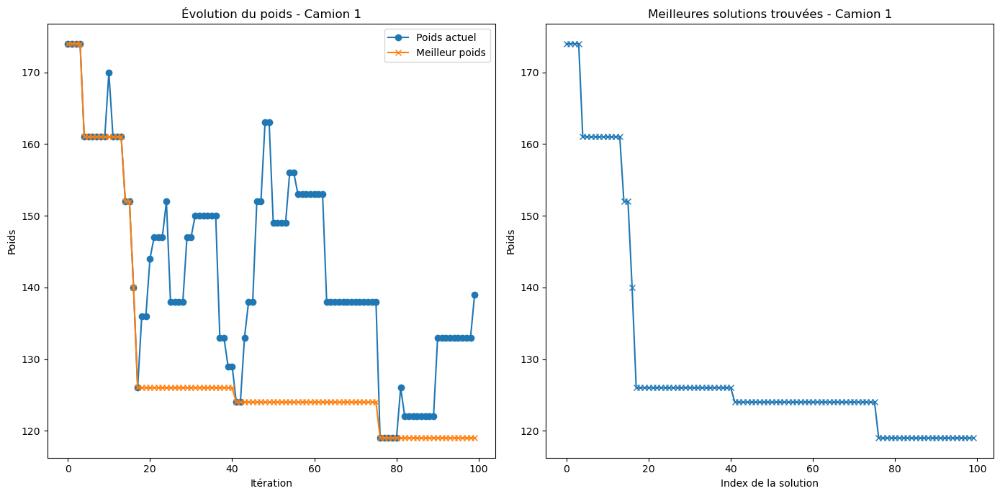

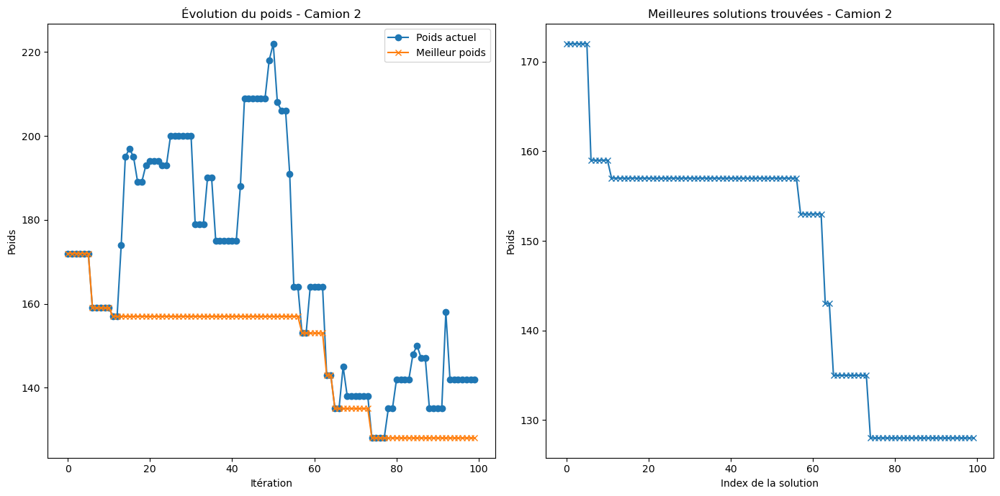

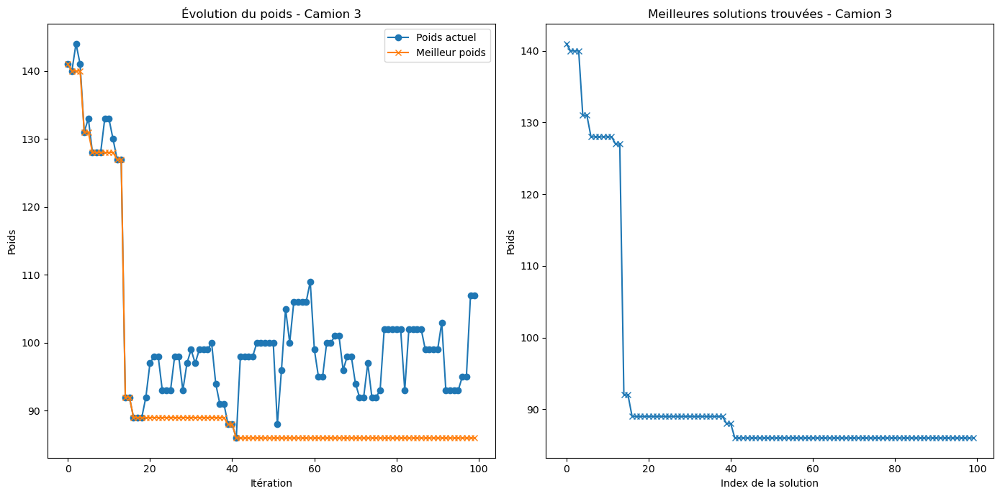

In [7]:
# Afficher le graphe avec les chemins optimaux
draw_weighted_graph(G, all_paths)

# Graphiques des mesures de performance
plt.figure(figsize=(14, 7))

plt.subplot(1, 3, 1)
plt.plot(range(1, len(truck_assignments) + 1), times, marker='o')
plt.title('Temps de calcul par camion')
plt.xlabel('Camion')
plt.ylabel('Temps (s)')

plt.subplot(1, 3, 2)
plt.plot(range(1, len(truck_assignments) + 1), memory_usages, marker='o')
plt.title('Utilisation de la mémoire par camion')
plt.xlabel('Camion')
plt.ylabel('Mémoire (Ko)')

plt.subplot(1, 3, 3)
plt.plot(range(1, len(truck_assignments) + 1), total_weights, marker='o')
plt.title('Poids total du chemin par camion')
plt.xlabel('Camion')
plt.ylabel('Poids total')

plt.tight_layout()
plt.show()

# Graphiques des itérations et des solutions
for i, iteration_data in enumerate(all_iterations_data):
    iterations, current_weights, best_weights = zip(*iteration_data)
    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(iterations, current_weights, marker='o', label='Poids actuel')
    plt.plot(iterations, best_weights, marker='x', label='Meilleur poids')
    plt.title(f'Évolution du poids - Camion {i + 1}')
    plt.xlabel('Itération')
    plt.ylabel('Poids')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(best_weights, marker='x')
    plt.title(f'Meilleures solutions trouvées - Camion {i + 1}')
    plt.xlabel('Index de la solution')
    plt.ylabel('Poids')

    plt.tight_layout()
    plt.show()

## PARTIE 3 : Cas de test + Étude expérimentale

#### Ici, nous avons définis 4 cas de test pour tester notre algorithme dans différentes situations, nous allons collecter quelques métriques, nous allons les analyser et donner nos observations et nos remarques. 
#### Remarque : on laisseras dans nos tests un volume de 20m3 pour les camions, et nos colis seront compris entre 0.5 et 3m3. 

### Cas de test 1 : 200 villes, 50 colis et 500 itérations

Informations sur les colis :
Colis 1 -> Destination: 60, Volume: 1.1 m3
Colis 2 -> Destination: 113, Volume: 1.3 m3
Colis 3 -> Destination: 161, Volume: 1.1 m3
Colis 4 -> Destination: 11, Volume: 1.6 m3
Colis 5 -> Destination: 84, Volume: 0.6 m3
Colis 6 -> Destination: 69, Volume: 1.6 m3
Colis 7 -> Destination: 107, Volume: 1.1 m3
Colis 8 -> Destination: 167, Volume: 2.3 m3
Colis 9 -> Destination: 71, Volume: 1.7 m3
Colis 10 -> Destination: 61, Volume: 1.6 m3
Colis 11 -> Destination: 53, Volume: 1.6 m3
Colis 12 -> Destination: 190, Volume: 2.5 m3
Colis 13 -> Destination: 185, Volume: 2.5 m3
Colis 14 -> Destination: 149, Volume: 2.0 m3
Colis 15 -> Destination: 176, Volume: 2.2 m3
Colis 16 -> Destination: 40, Volume: 0.7 m3
Colis 17 -> Destination: 175, Volume: 2.8 m3
Colis 18 -> Destination: 120, Volume: 2.4 m3
Colis 19 -> Destination: 26, Volume: 2.3 m3
Colis 20 -> Destination: 148, Volume: 1.9 m3
Colis 21 -> Destination: 68, Volume: 0.6 m3
Colis 22 -> Destination: 171, Volume: 2.6 m3


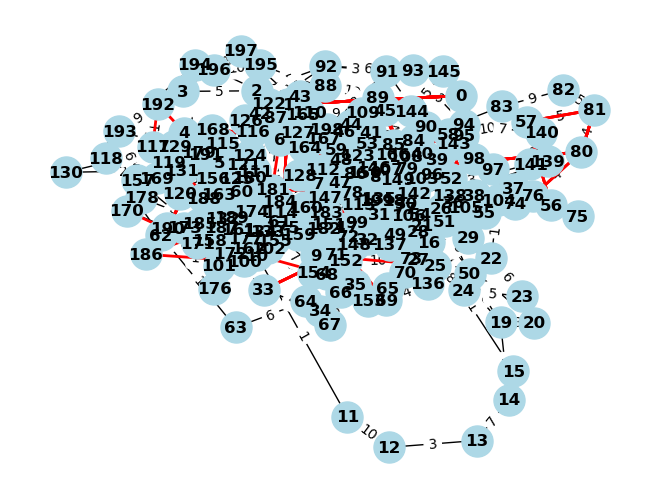

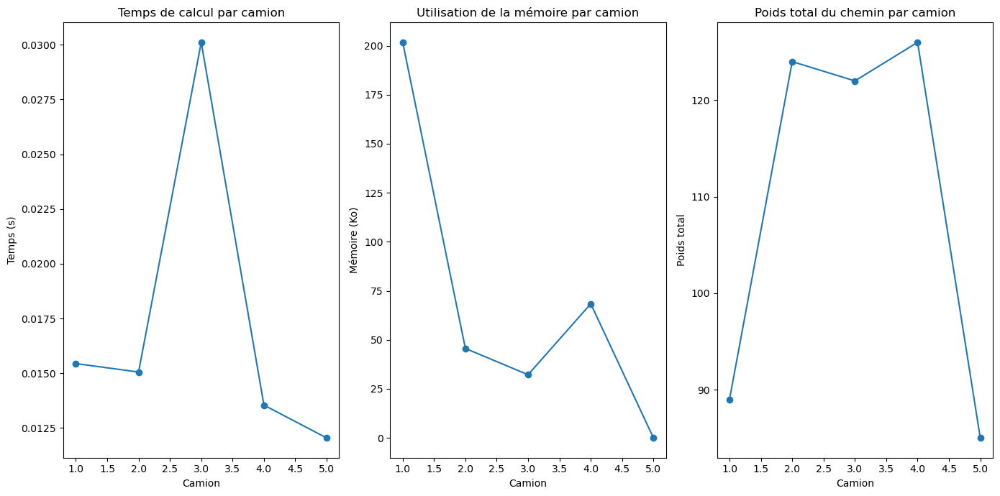

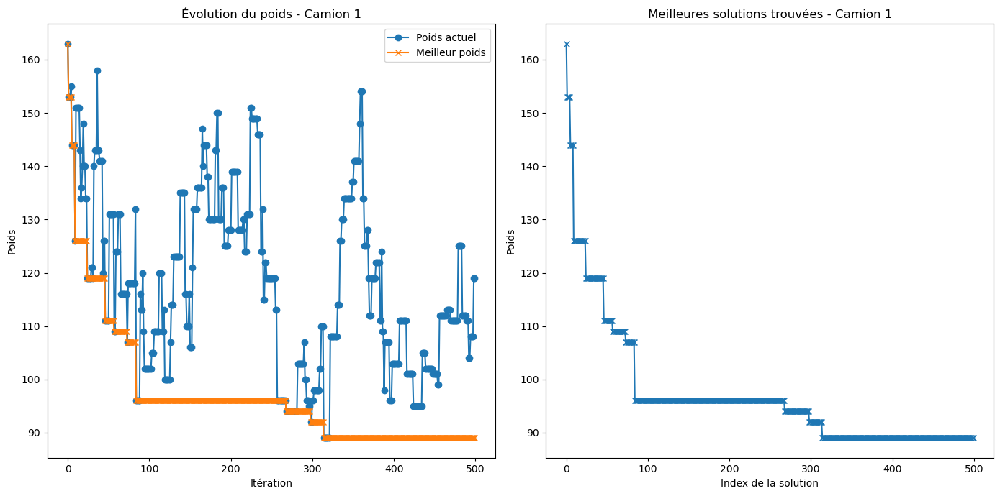

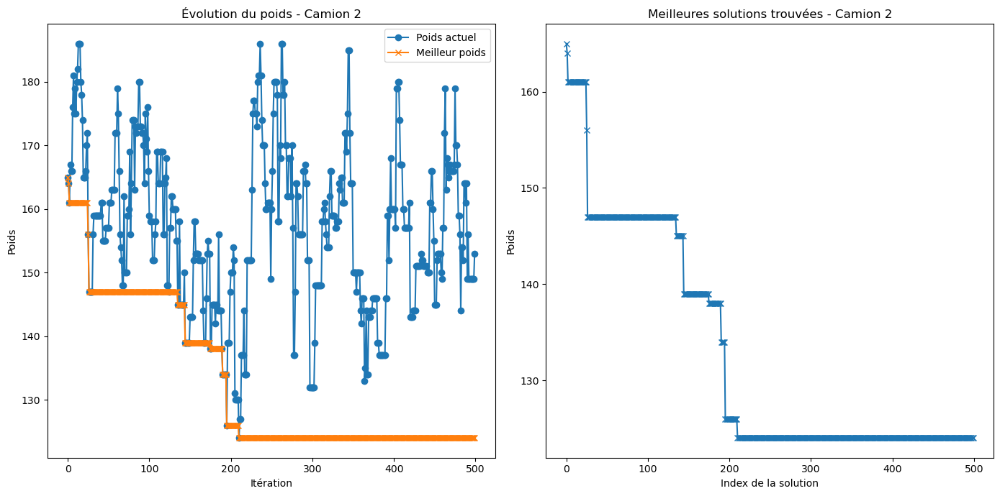

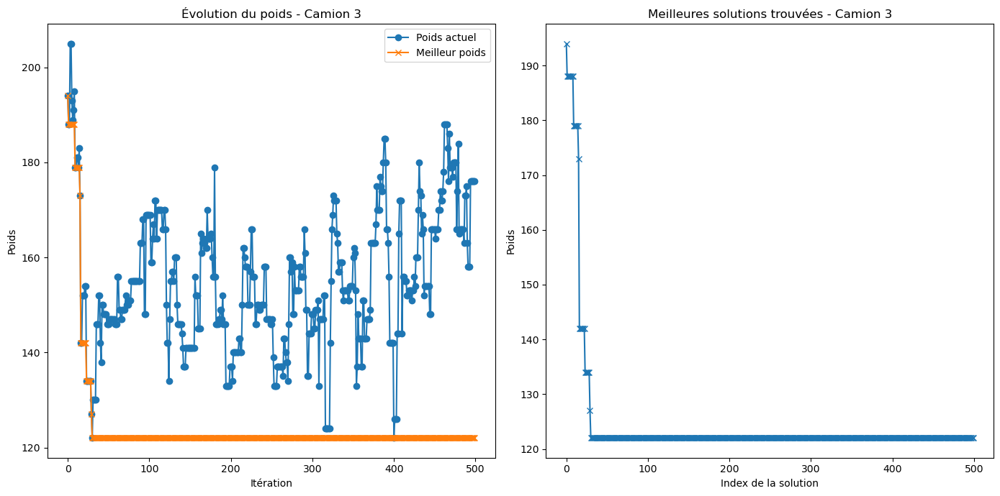

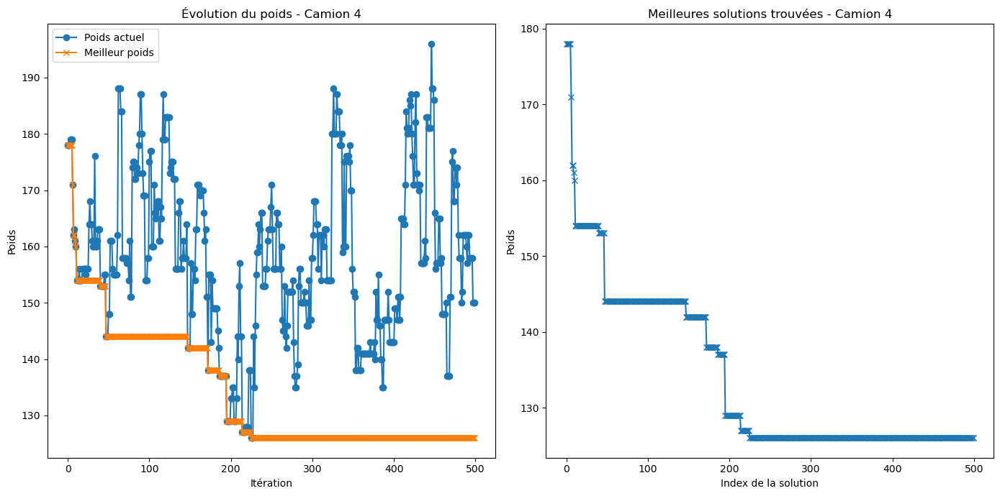

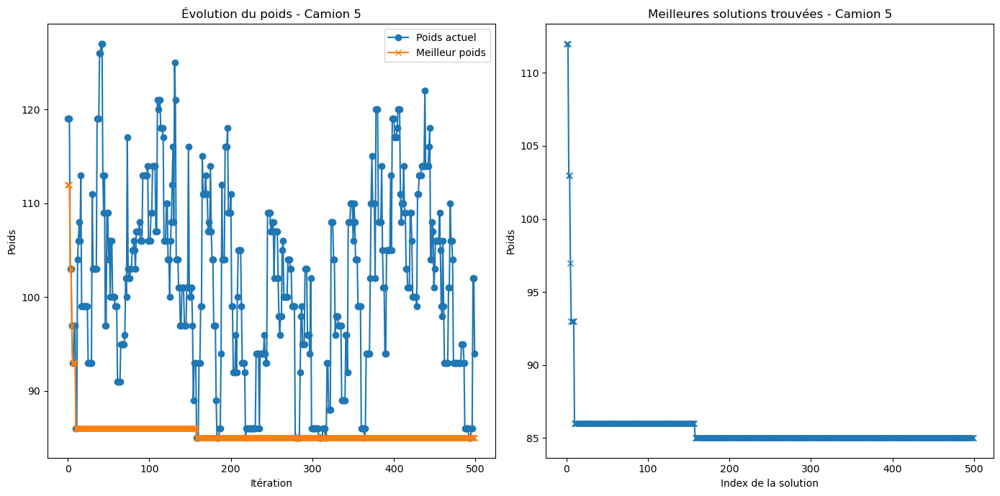

In [19]:
# Paramètres du problème
n = 200
num_packages = 50
truck_capacity = 20  # Capacité des camions en m3
max_iterations = 500

# Générer le graphe
G = generate_weighted_connected_graph(n)

# Pré-calculer les chemins de Dijkstra pour toutes les paires de nœuds
all_paths = dict(nx.all_pairs_dijkstra_path(G, weight='weight'))

# Calculer les plus courts chemins entre toutes les paires de nœuds
path_lengths = dict(nx.all_pairs_dijkstra_path_length(G, weight='weight'))

# Générer les colis et leurs volumes
packages = [(random.randint(0, n - 1), round(random.uniform(0.5, 3), 1)) for _ in range(num_packages)]
package_volumes = [round(vol, 1) for _, vol in packages]

# Afficher les informations sur les colis
print("Informations sur les colis :")
for i, (destination, volume) in enumerate(packages):
    print(f"Colis {i + 1} -> Destination: {destination}, Volume: {volume} m3")

# Ajuster les volumes pour le problème de sac à dos
scaled_volumes = [int(vol * 10) for vol in package_volumes]
scaled_capacity = int(truck_capacity * 10)

# Distribuer les colis dans les camions
trucks = distribute_packages(scaled_volumes, scaled_capacity)
truck_assignments = [[packages[i][0] for i in truck] for truck in trucks]

# Mesurer le temps d'exécution total du programme
total_start_time = time.time()
tracemalloc.start()

# Exécuter le recuit simulé pour chaque camion en parallèle
results = []
with concurrent.futures.ThreadPoolExecutor() as executor:
    futures = [executor.submit(optimize_path, points) for points in truck_assignments]
    results = [f.result() for f in futures]
    
# Mesurer la mémoire totale utilisée par le programme
total_mem_usage = tracemalloc.get_traced_memory()[1] / 1024  # Convert to KB
tracemalloc.stop()
total_exec_time = time.time() - total_start_time

# Extraire les résultats
all_paths, total_weights, all_iterations_data, times, memory_usages = zip(*results)

# Calcul de l'utilisation moyenne de la mémoire
avg_memory_usage = sum(memory_usages) / len(memory_usages)
total_path_weight = sum(total_weights)
weight_per_truck = total_path_weight / len(truck_assignments)

for i, (optimal_path, total_weight, iteration_data, exec_time, mem_usage) in enumerate(results):
    print(f"\nPoints de passage pour le camion {i + 1} : {truck_assignments[i]}")
    print(f"Chemin optimal pour le camion {i + 1} : {optimal_path}")
    print(f"Poids total du chemin pour le camion {i + 1} : {total_weight}")
    print(f"Temps de calcul : {exec_time:.4f} secondes")
    print(f"Utilisation de la mémoire : {mem_usage:.2f} Ko")
    
print(f"\nTemps d'exécution total du programme : {total_exec_time:.4f} secondes")
print(f"Utilisation moyenne de la mémoire : {avg_memory_usage:.2f} Ko")
print(f"Poids total de tous les chemins : {total_path_weight}")
print(f"Poids moyen par camion : {weight_per_truck}")

# Afficher le graphe avec les chemins optimaux
draw_weighted_graph(G, all_paths)

# Graphiques des mesures de performance
plt.figure(figsize=(14, 7))

plt.subplot(1, 3, 1)
plt.plot(range(1, len(truck_assignments) + 1), times, marker='o')
plt.title('Temps de calcul par camion')
plt.xlabel('Camion')
plt.ylabel('Temps (s)')

plt.subplot(1, 3, 2)
plt.plot(range(1, len(truck_assignments) + 1), memory_usages, marker='o')
plt.title('Utilisation de la mémoire par camion')
plt.xlabel('Camion')
plt.ylabel('Mémoire (Ko)')

plt.subplot(1, 3, 3)
plt.plot(range(1, len(truck_assignments) + 1), total_weights, marker='o')
plt.title('Poids total du chemin par camion')
plt.xlabel('Camion')
plt.ylabel('Poids total')

plt.tight_layout()
plt.show()

# Graphiques des itérations et des solutions
for i, iteration_data in enumerate(all_iterations_data):
    iterations, current_weights, best_weights = zip(*iteration_data)
    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(iterations, current_weights, marker='o', label='Poids actuel')
    plt.plot(iterations, best_weights, marker='x', label='Meilleur poids')
    plt.title(f'Évolution du poids - Camion {i + 1}')
    plt.xlabel('Itération')
    plt.ylabel('Poids')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(best_weights, marker='x')
    plt.title(f'Meilleures solutions trouvées - Camion {i + 1}')
    plt.xlabel('Index de la solution')
    plt.ylabel('Poids')

    plt.tight_layout()
    plt.show()

#### On relève ici nos 3 métriques : 
#### Temps d'exécution total du programme : 0.0577 secondes. Ce temps est très faible étant donné le nombre de ville, de colis ainsi que le nombre d'itérations. Le fait d'utiliser le multi-threading est aussi une cause de ce temps presque négligeable.
#### Utilisation moyenne de la mémoire : 76.56 Ko. Pareil que pour le temps, elle est très faible. Ce chiffre peut être faussé car certains camions se calculent tellement vite que le code n'a pas le temps de récuperer les information sur la mémoire utilisée. 
#### Poids (distance) total de tous les chemins : 637. Ce poids est assez cohérent (moyenne de 109.2 par camion). Du fait qu'on ne fais que très peu d'itérations, il peux surement être améliorer pour ce nombre de ville et de colis.  
#### Ce cas est très peu représentatif car il utilise de très petite instance. Certes, les résultats sont quasiment instantanés mais ils ne sont surement pas optimisés.


### Cas de test 2 : 500 villes, 250 colis et 1000 itérations

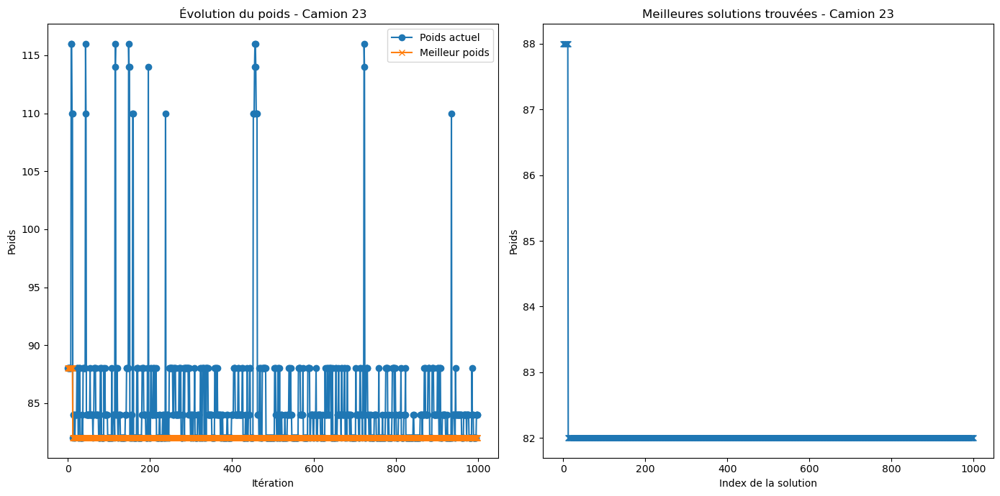

In [ ]:
# Paramètres du problème
n = 500
num_packages = 250
truck_capacity = 20  # Capacité des camions en m3
max_iterations = 1000

# Générer le graphe
G = generate_weighted_connected_graph(n)

# Pré-calculer les chemins de Dijkstra pour toutes les paires de nœuds
all_paths = dict(nx.all_pairs_dijkstra_path(G, weight='weight'))

# Calculer les plus courts chemins entre toutes les paires de nœuds
path_lengths = dict(nx.all_pairs_dijkstra_path_length(G, weight='weight'))

# Générer les colis et leurs volumes
packages = [(random.randint(0, n - 1), round(random.uniform(0.5, 3), 1)) for _ in range(num_packages)]
package_volumes = [round(vol, 1) for _, vol in packages]

# Afficher les informations sur les colis
print("Informations sur les colis :")
for i, (destination, volume) in enumerate(packages):
    print(f"Colis {i + 1} -> Destination: {destination}, Volume: {volume} m3")

# Ajuster les volumes pour le problème de sac à dos
scaled_volumes = [int(vol * 10) for vol in package_volumes]
scaled_capacity = int(truck_capacity * 10)

# Distribuer les colis dans les camions
trucks = distribute_packages(scaled_volumes, scaled_capacity)
truck_assignments = [[packages[i][0] for i in truck] for truck in trucks]

# Mesurer le temps d'exécution total du programme
total_start_time = time.time()
tracemalloc.start()

# Exécuter le recuit simulé pour chaque camion en parallèle
results = []
with concurrent.futures.ThreadPoolExecutor() as executor:
    futures = [executor.submit(optimize_path, points) for points in truck_assignments]
    results = [f.result() for f in futures]
    
# Mesurer la mémoire totale utilisée par le programme
total_mem_usage = tracemalloc.get_traced_memory()[1] / 1024  # Convert to KB
tracemalloc.stop()
total_exec_time = time.time() - total_start_time

# Extraire les résultats
all_paths, total_weights, all_iterations_data, times, memory_usages = zip(*results)

# Calcul de l'utilisation moyenne de la mémoire
avg_memory_usage = sum(memory_usages) / len(memory_usages)
total_path_weight = sum(total_weights)
weight_per_truck = total_path_weight / len(truck_assignments)

for i, (optimal_path, total_weight, iteration_data, exec_time, mem_usage) in enumerate(results):
    print(f"\nPoints de passage pour le camion {i + 1} : {truck_assignments[i]}")
    print(f"Chemin optimal pour le camion {i + 1} : {optimal_path}")
    print(f"Poids total du chemin pour le camion {i + 1} : {total_weight}")
    print(f"Temps de calcul : {exec_time:.4f} secondes")
    print(f"Utilisation de la mémoire : {mem_usage:.2f} Ko")
    
print(f"\nTemps d'exécution total du programme : {total_exec_time:.4f} secondes")
print(f"Utilisation moyenne de la mémoire : {avg_memory_usage:.2f} Ko")
print(f"Poids total de tous les chemins : {total_path_weight}")
print(f"Poids moyen par camion : {weight_per_truck}")

# Afficher le graphe avec les chemins optimaux
draw_weighted_graph(G, all_paths)

# Graphiques des mesures de performance
plt.figure(figsize=(14, 7))

plt.subplot(1, 3, 1)
plt.plot(range(1, len(truck_assignments) + 1), times, marker='o')
plt.title('Temps de calcul par camion')
plt.xlabel('Camion')
plt.ylabel('Temps (s)')

plt.subplot(1, 3, 2)
plt.plot(range(1, len(truck_assignments) + 1), memory_usages, marker='o')
plt.title('Utilisation de la mémoire par camion')
plt.xlabel('Camion')
plt.ylabel('Mémoire (Ko)')

plt.subplot(1, 3, 3)
plt.plot(range(1, len(truck_assignments) + 1), total_weights, marker='o')
plt.title('Poids total du chemin par camion')
plt.xlabel('Camion')
plt.ylabel('Poids total')

plt.tight_layout()
plt.show()

# Graphiques des itérations et des solutions
for i, iteration_data in enumerate(all_iterations_data):
    iterations, current_weights, best_weights = zip(*iteration_data)
    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(iterations, current_weights, marker='o', label='Poids actuel')
    plt.plot(iterations, best_weights, marker='x', label='Meilleur poids')
    plt.title(f'Évolution du poids - Camion {i + 1}')
    plt.xlabel('Itération')
    plt.ylabel('Poids')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(best_weights, marker='x')
    plt.title(f'Meilleures solutions trouvées - Camion {i + 1}')
    plt.xlabel('Index de la solution')
    plt.ylabel('Poids')

    plt.tight_layout()
    plt.show()

#### On relève ici nos 3 métriques : 
#### Temps d'exécution total du programme : 0.5564 secondes. Ce temps est aussi très faible même en ayant doublé voir plus toutes les paramêtres. Il reste négligeable. 
#### Utilisation moyenne de la mémoire : 69.29 Ko. Pareil que pour le temps, elle est très faible. Ce chiffre peut être faussé car certains camions se calculent tellement vite que le code n'a pas le temps de récuperer les information sur la mémoire utilisée. 
#### Poids (distance) total de tous les chemins : 3844. Ce poids est cohérent (moyenne de 167.13 par camion). Le poids total et moyen a augmenté car les paramêtres ont augmenté. En augmentant le nombre de colis, on augmente forcement le nombre de camions, ce qui créer des nouveaux trajets et donc augmente le poids total. Néanmoins, le poids n'a pas drastiquement augmenté et reste assez faible.   
#### Ce cas de test nous donne des résultats plus précis et plus concret même si ils peuvent toujours être optimisés. Ce cas se rapproche plus d'un cas réel. 

### Cas de test 3 : 1000 villes, 500 colis et 3000 itérations

Informations sur les colis :
Colis 1 -> Destination: 451, Volume: 2.1 m3
Colis 2 -> Destination: 570, Volume: 0.8 m3
Colis 3 -> Destination: 79, Volume: 1.9 m3
Colis 4 -> Destination: 371, Volume: 1.5 m3
Colis 5 -> Destination: 895, Volume: 1.9 m3
Colis 6 -> Destination: 27, Volume: 1.2 m3
Colis 7 -> Destination: 109, Volume: 2.2 m3
Colis 8 -> Destination: 911, Volume: 1.1 m3
Colis 9 -> Destination: 147, Volume: 2.8 m3
Colis 10 -> Destination: 205, Volume: 2.7 m3
Colis 11 -> Destination: 83, Volume: 2.1 m3
Colis 12 -> Destination: 219, Volume: 1.0 m3
Colis 13 -> Destination: 967, Volume: 2.5 m3
Colis 14 -> Destination: 538, Volume: 1.8 m3
Colis 15 -> Destination: 190, Volume: 2.1 m3
Colis 16 -> Destination: 860, Volume: 1.3 m3
Colis 17 -> Destination: 595, Volume: 1.5 m3
Colis 18 -> Destination: 245, Volume: 1.9 m3
Colis 19 -> Destination: 835, Volume: 2.4 m3
Colis 20 -> Destination: 428, Volume: 1.5 m3
Colis 21 -> Destination: 651, Volume: 1.2 m3
Colis 22 -> Destination: 330, Volume: 


Points de passage pour le camion 1 : [295, 330, 506, 219, 476, 967, 428, 860, 428, 147, 330]
Chemin optimal pour le camion 1 : [0, 586, 587, 295, 587, 533, 534, 200, 429, 428, 816, 815, 541, 727, 288, 219, 288, 287, 147, 476, 477, 365, 58, 345, 329, 330, 331, 862, 861, 860, 859, 835, 836, 797, 967, 50, 49, 194, 258, 259, 260, 914, 915, 506, 505, 984, 983, 616, 0]
Poids total du chemin pour le camion 1 : 145
Temps de calcul : 0.1902 secondes
Utilisation de la mémoire : 700.92 Ko

Points de passage pour le camion 2 : [219, 83, 428, 967, 567, 428, 860, 538, 330, 835, 83, 918]
Chemin optimal pour le camion 2 : [0, 586, 587, 533, 534, 200, 429, 428, 816, 815, 541, 727, 288, 219, 288, 289, 290, 133, 838, 837, 836, 797, 967, 797, 836, 835, 859, 860, 861, 862, 331, 330, 329, 753, 802, 655, 461, 108, 82, 83, 82, 108, 107, 11, 538, 539, 478, 479, 70, 568, 744, 916, 917, 918, 920, 945, 946, 177, 566, 567, 566, 177, 946, 945, 191, 615, 616, 0]
Poids total du chemin pour le camion 2 : 163
Temps de

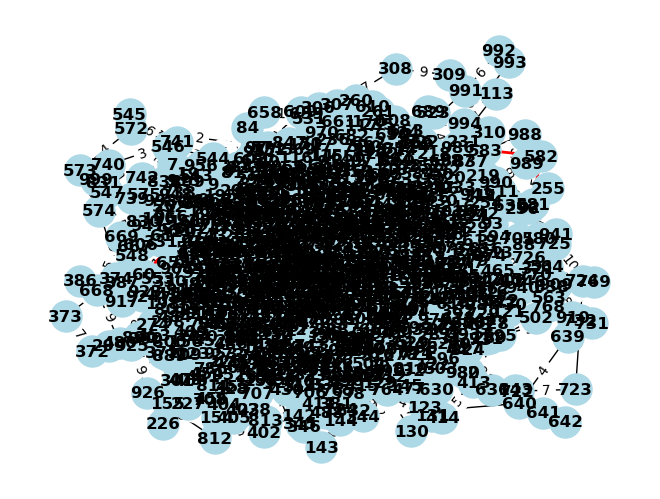

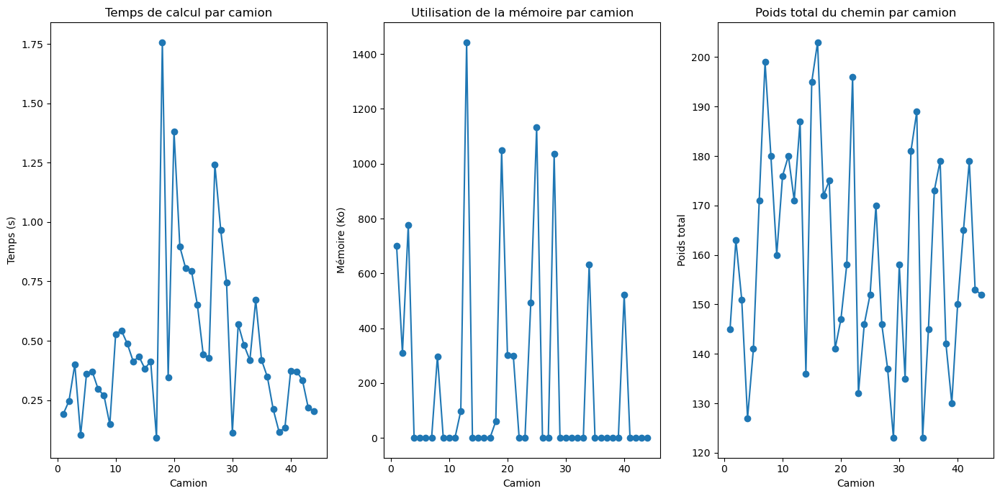

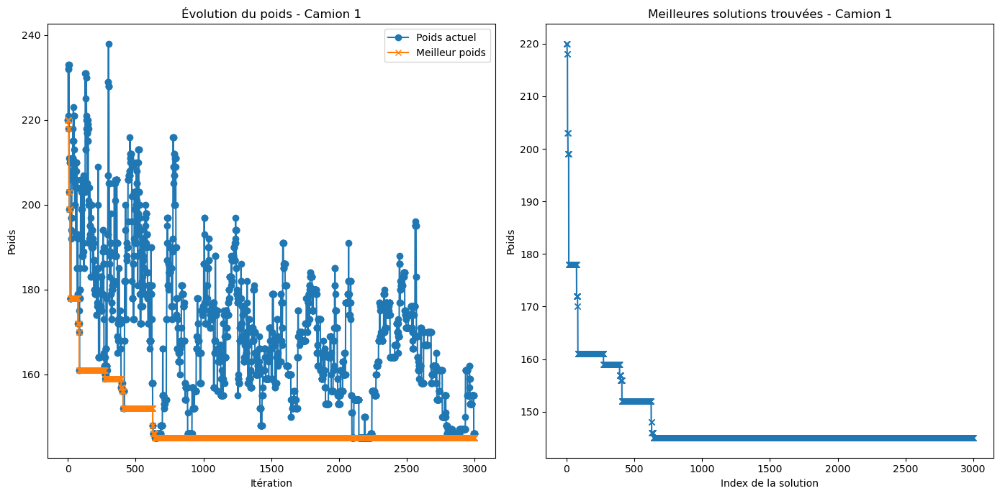

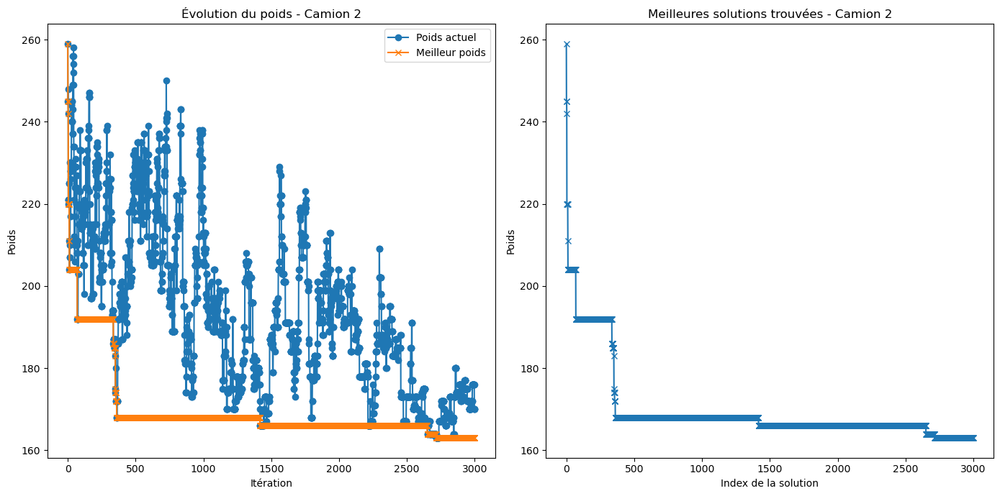

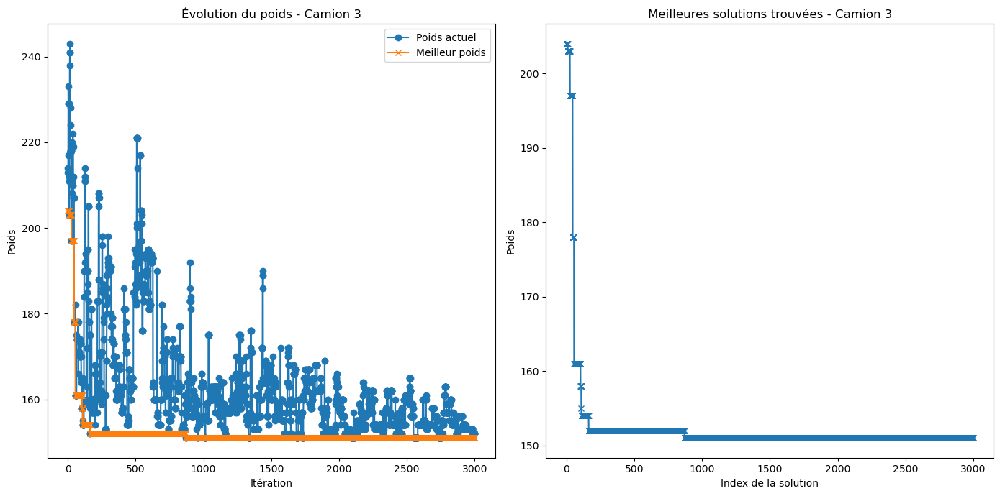

...

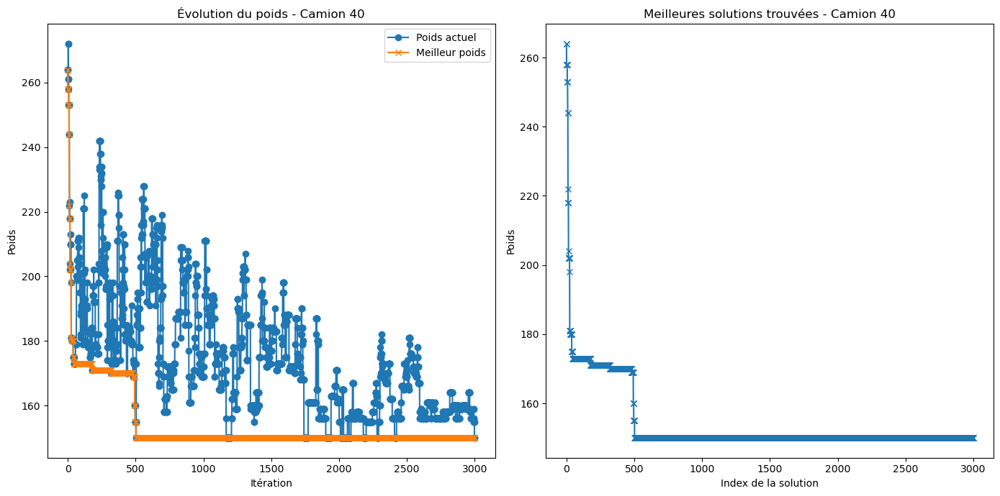

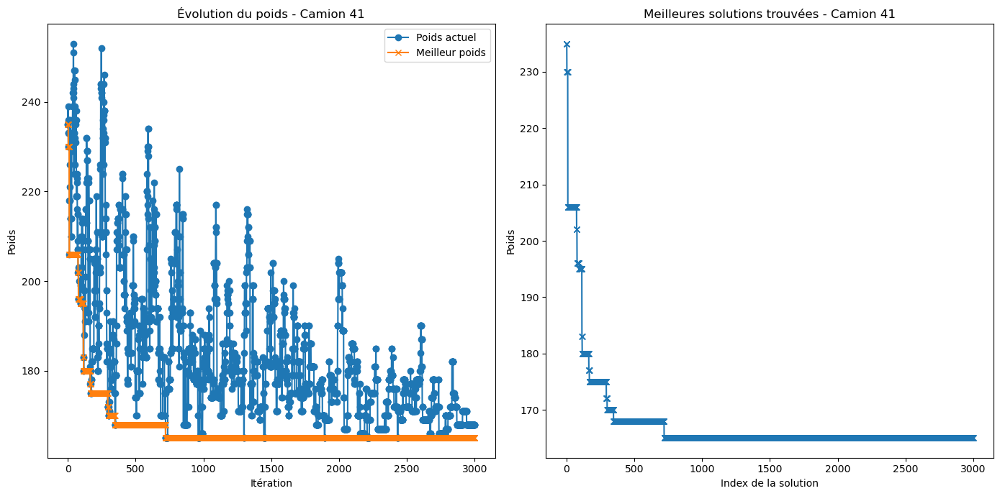

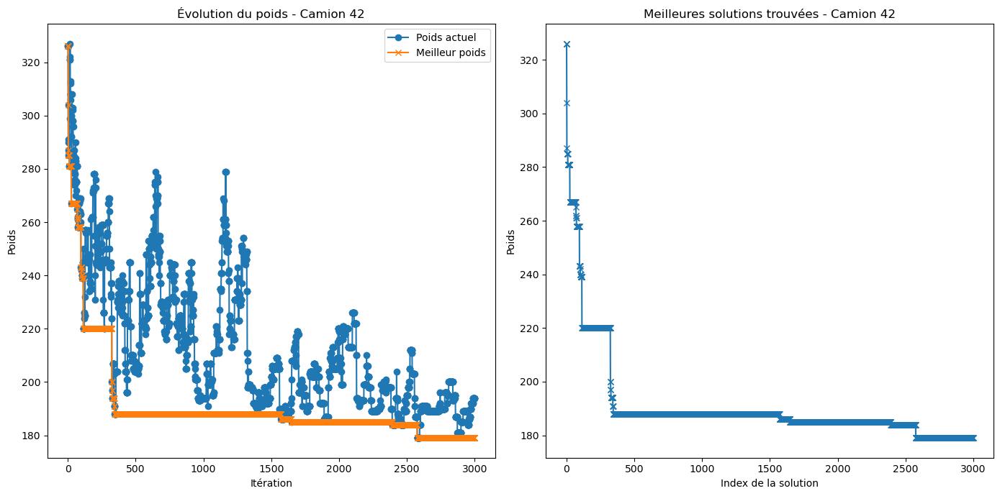

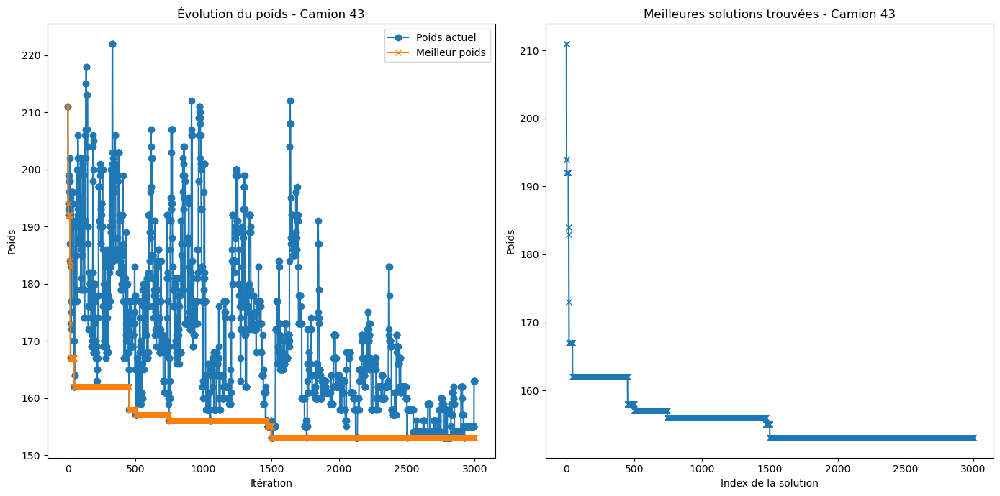

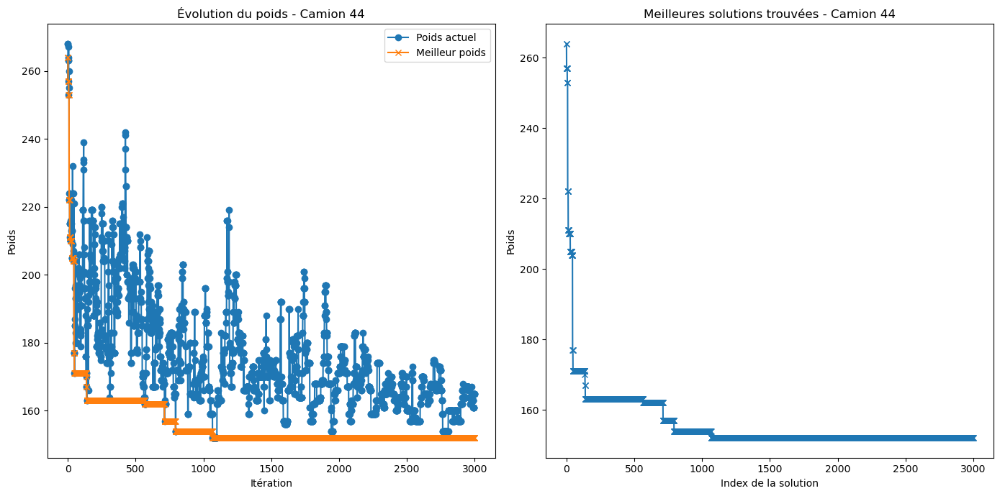

In [22]:
# Paramètres du problème
n = 1000
num_packages = 500
truck_capacity = 20  # Capacité des camions en m3
max_iterations = 3000

# Générer le graphe
G = generate_weighted_connected_graph(n)

# Pré-calculer les chemins de Dijkstra pour toutes les paires de nœuds
all_paths = dict(nx.all_pairs_dijkstra_path(G, weight='weight'))

# Calculer les plus courts chemins entre toutes les paires de nœuds
path_lengths = dict(nx.all_pairs_dijkstra_path_length(G, weight='weight'))

# Générer les colis et leurs volumes
packages = [(random.randint(0, n - 1), round(random.uniform(0.5, 3), 1)) for _ in range(num_packages)]
package_volumes = [round(vol, 1) for _, vol in packages]

# Afficher les informations sur les colis
print("Informations sur les colis :")
for i, (destination, volume) in enumerate(packages):
    print(f"Colis {i + 1} -> Destination: {destination}, Volume: {volume} m3")

# Ajuster les volumes pour le problème de sac à dos
scaled_volumes = [int(vol * 10) for vol in package_volumes]
scaled_capacity = int(truck_capacity * 10)

# Distribuer les colis dans les camions
trucks = distribute_packages(scaled_volumes, scaled_capacity)
truck_assignments = [[packages[i][0] for i in truck] for truck in trucks]

# Mesurer le temps d'exécution total du programme
total_start_time = time.time()
tracemalloc.start()

# Exécuter le recuit simulé pour chaque camion en parallèle
results = []
with concurrent.futures.ThreadPoolExecutor() as executor:
    futures = [executor.submit(optimize_path, points) for points in truck_assignments]
    results = [f.result() for f in futures]
    
# Mesurer la mémoire totale utilisée par le programme
total_mem_usage = tracemalloc.get_traced_memory()[1] / 1024  # Convert to KB
tracemalloc.stop()
total_exec_time = time.time() - total_start_time

# Extraire les résultats
all_paths, total_weights, all_iterations_data, times, memory_usages = zip(*results)

# Calcul de l'utilisation moyenne de la mémoire
avg_memory_usage = sum(memory_usages) / len(memory_usages)
total_path_weight = sum(total_weights)
weight_per_truck = total_path_weight / len(truck_assignments)

for i, (optimal_path, total_weight, iteration_data, exec_time, mem_usage) in enumerate(results):
    print(f"\nPoints de passage pour le camion {i + 1} : {truck_assignments[i]}")
    print(f"Chemin optimal pour le camion {i + 1} : {optimal_path}")
    print(f"Poids total du chemin pour le camion {i + 1} : {total_weight}")
    print(f"Temps de calcul : {exec_time:.4f} secondes")
    print(f"Utilisation de la mémoire : {mem_usage:.2f} Ko")
    
print(f"\nTemps d'exécution total du programme : {total_exec_time:.4f} secondes")
print(f"Utilisation moyenne de la mémoire : {avg_memory_usage:.2f} Ko")
print(f"Poids total de tous les chemins : {total_path_weight}")
print(f"Poids moyen par camion : {weight_per_truck}")

# Afficher le graphe avec les chemins optimaux
draw_weighted_graph(G, all_paths)

# Graphiques des mesures de performance
plt.figure(figsize=(14, 7))

plt.subplot(1, 3, 1)
plt.plot(range(1, len(truck_assignments) + 1), times, marker='o')
plt.title('Temps de calcul par camion')
plt.xlabel('Camion')
plt.ylabel('Temps (s)')

plt.subplot(1, 3, 2)
plt.plot(range(1, len(truck_assignments) + 1), memory_usages, marker='o')
plt.title('Utilisation de la mémoire par camion')
plt.xlabel('Camion')
plt.ylabel('Mémoire (Ko)')

plt.subplot(1, 3, 3)
plt.plot(range(1, len(truck_assignments) + 1), total_weights, marker='o')
plt.title('Poids total du chemin par camion')
plt.xlabel('Camion')
plt.ylabel('Poids total')

plt.tight_layout()
plt.show()

# Graphiques des itérations et des solutions
for i, iteration_data in enumerate(all_iterations_data):
    iterations, current_weights, best_weights = zip(*iteration_data)
    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(iterations, current_weights, marker='o', label='Poids actuel')
    plt.plot(iterations, best_weights, marker='x', label='Meilleur poids')
    plt.title(f'Évolution du poids - Camion {i + 1}')
    plt.xlabel('Itération')
    plt.ylabel('Poids')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(best_weights, marker='x')
    plt.title(f'Meilleures solutions trouvées - Camion {i + 1}')
    plt.xlabel('Index de la solution')
    plt.ylabel('Poids')

    plt.tight_layout()
    plt.show()

#### On relève ici nos 3 métriques : 
#### Temps d'exécution total du programme : 3.2632 secondes. Ce temps reste faible mais il n'est plus négligeable. On remarque une nette augmentation du temps d'exécution comparé au cas de test précédent. Cela est du a un nombre beacoup plus important de villes, colis mais surtout d'itérations.
#### Utilisation moyenne de la mémoire : 208,01 Ko. Pareil que pour le temps, elle est assez faible. On remarque cependant une nette augmentation de celle ci comparé au cas précédent. Ce résultat reste très satisfaisant. Ce chiffre peut être faussé car certains camions se calculent tellement vite que le code n'a pas le temps de récuperer les information sur la mémoire utilisée. 
#### Poids (distance) total de tous les chemins : 7034. Ce poids est cohérent (moyenne de 159.86 par camion). Le poids total a augmenté car le nombre de camions a augmenté. Le poids moyen lui a un petit peu diminué, ce qui montre que les résultats s'affinent quand le nombre d'itérations augmente.  
#### Ce cas de test nous donne des résultats bien précis que le cas précédent. On voit que quand on augmente fortement le nombre d'itération, les résultats s'affinent. Ce cas peut être considéré comme réaliste. 

Informations sur les colis :
Colis 1 -> Destination: 810, Volume: 1.8 m3
Colis 2 -> Destination: 2424, Volume: 1.4 m3
Colis 3 -> Destination: 1124, Volume: 1.7 m3
Colis 4 -> Destination: 2994, Volume: 2.0 m3
Colis 5 -> Destination: 968, Volume: 0.9 m3
Colis 6 -> Destination: 1092, Volume: 1.4 m3
Colis 7 -> Destination: 2784, Volume: 2.3 m3
Colis 8 -> Destination: 3740, Volume: 2.2 m3
Colis 9 -> Destination: 4038, Volume: 2.0 m3
Colis 10 -> Destination: 206, Volume: 1.0 m3
Colis 11 -> Destination: 2744, Volume: 1.6 m3
Colis 12 -> Destination: 3664, Volume: 1.0 m3
Colis 13 -> Destination: 1494, Volume: 1.0 m3
Colis 14 -> Destination: 3260, Volume: 2.9 m3
Colis 15 -> Destination: 370, Volume: 1.8 m3
Colis 16 -> Destination: 470, Volume: 2.1 m3
Colis 17 -> Destination: 1152, Volume: 2.8 m3
Colis 18 -> Destination: 2739, Volume: 1.9 m3
Colis 19 -> Destination: 3300, Volume: 3.0 m3
Colis 20 -> Destination: 3238, Volume: 2.4 m3
Colis 21 -> Destination: 2869, Volume: 1.4 m3
Colis 22 -> Destina

Resetting temperature at iteration 3653
Resetting temperature at iteration 4463
Resetting temperature at iteration 4826
Resetting temperature at iteration 4972
Resetting temperature at iteration 4484
Resetting temperature at iteration 4920

Points de passage pour le camion 1 : [573, 2744, 1152, 2744, 2869, 3853, 370, 206, 2869, 2739, 370, 3300]
Chemin optimal pour le camion 1 : [0, 1, 2, 3, 4175, 3493, 3492, 3491, 4541, 2530, 3602, 1229, 2693, 2694, 2869, 3528, 1192, 376, 375, 374, 2957, 3455, 3300, 2678, 1590, 1589, 3851, 3852, 3853, 3852, 2421, 2420, 370, 369, 368, 1222, 1223, 2740, 2739, 2740, 781, 780, 779, 204, 205, 206, 205, 888, 4467, 4468, 1652, 3458, 3459, 573, 3459, 3458, 4609, 4610, 2199, 2743, 2744, 2743, 51, 1671, 525, 2075, 1149, 1150, 1151, 1152, 1153, 1349, 4061, 1158, 2237, 2236, 4175, 3, 2, 1, 0]
Poids total du chemin pour le camion 1 : 263
Temps de calcul : 9.3432 secondes
Utilisation de la mémoire : 0.00 Ko

Points de passage pour le camion 2 : [3257, 555, 764, 3238

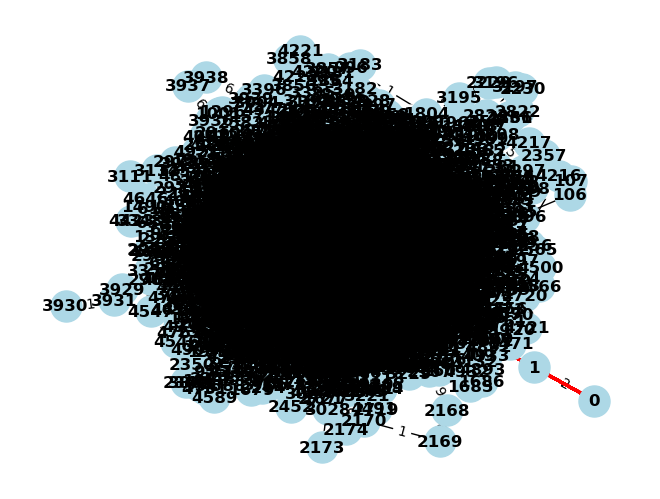

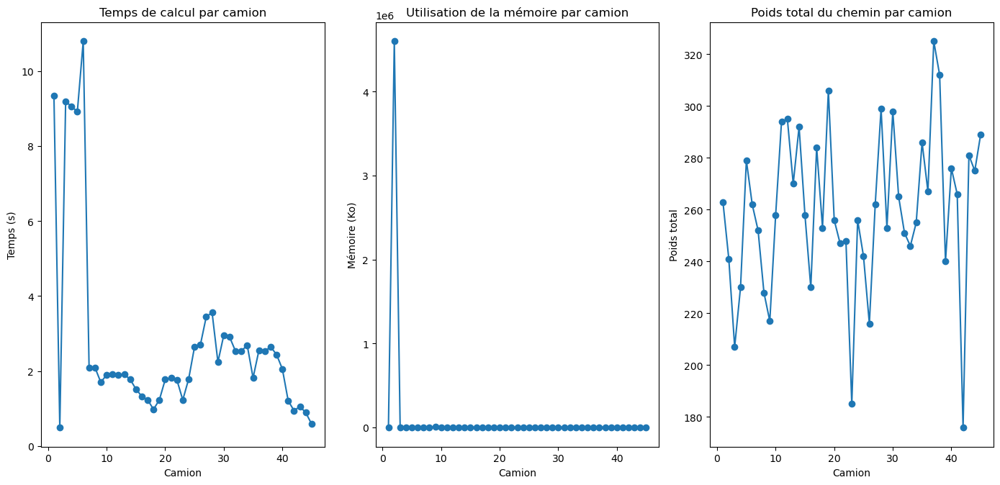

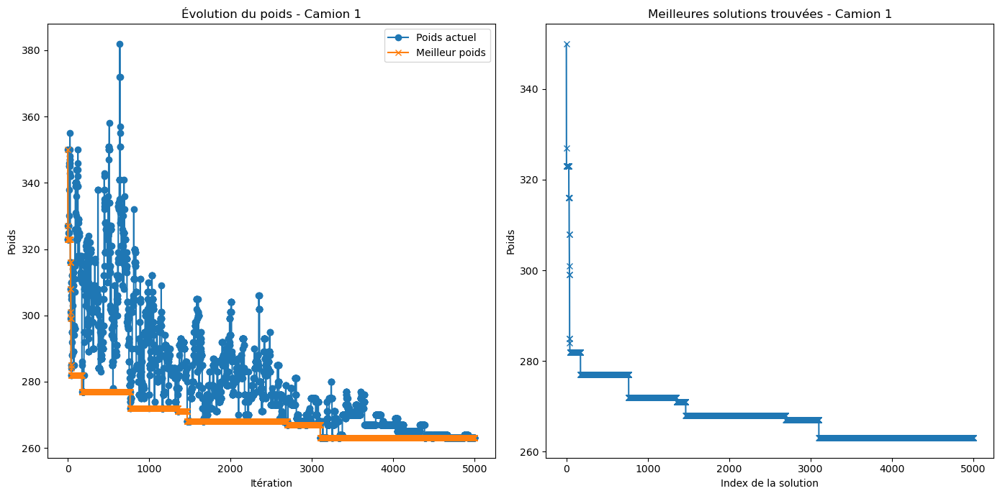

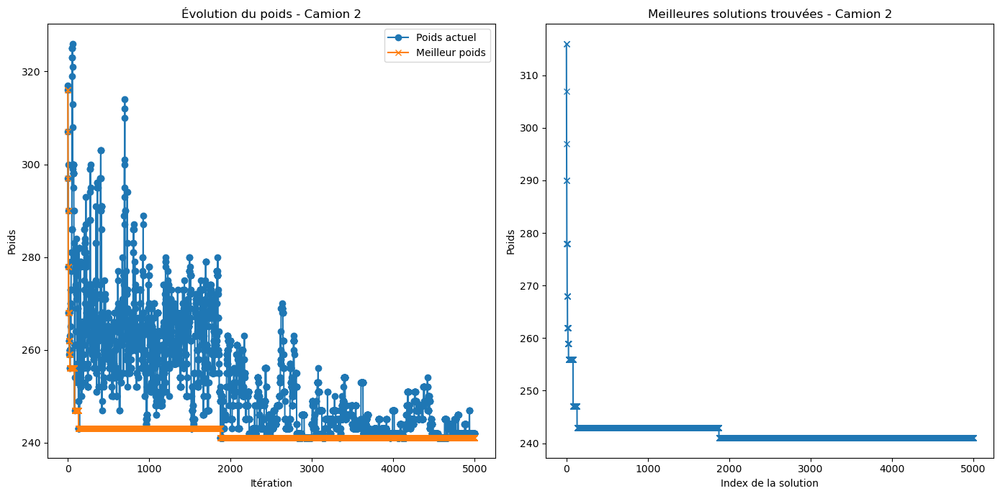

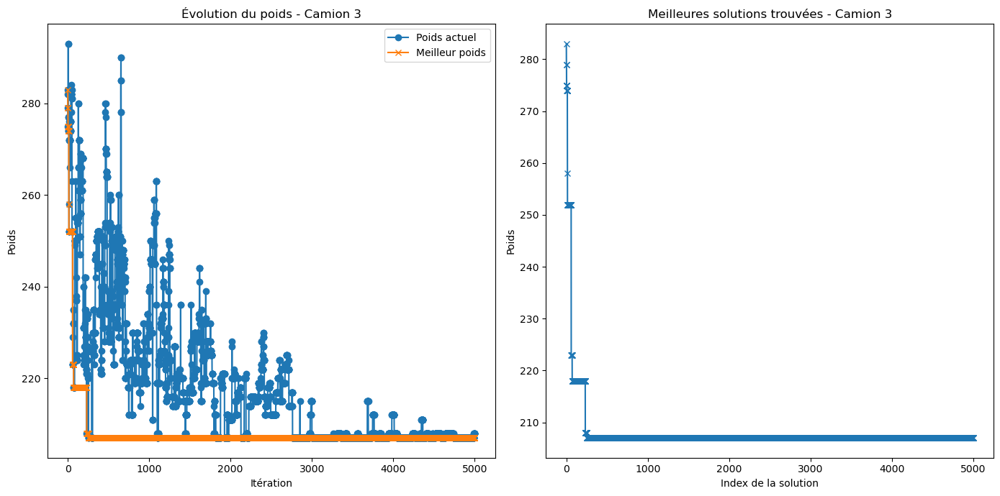

...

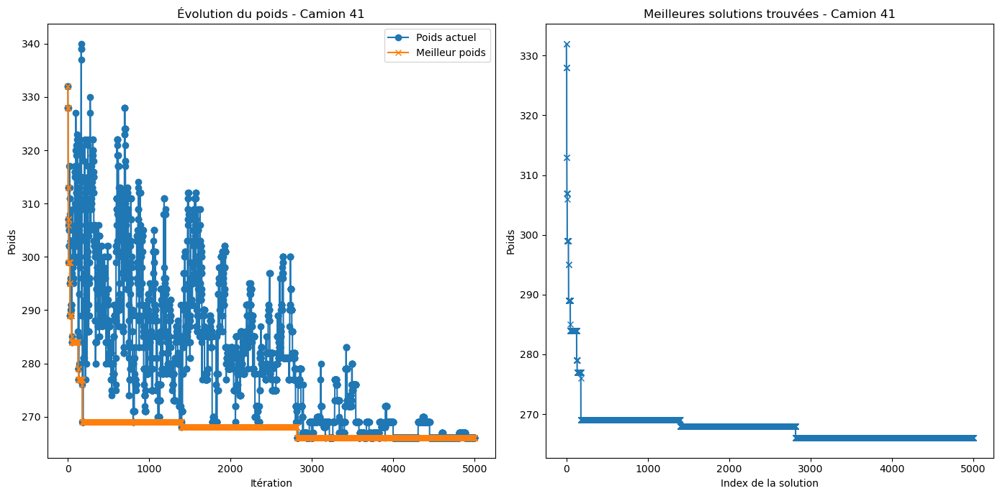

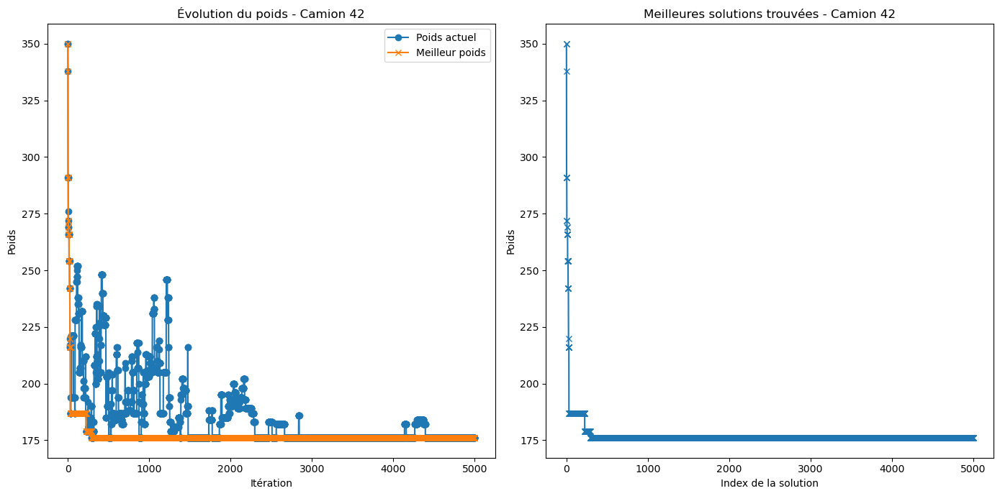

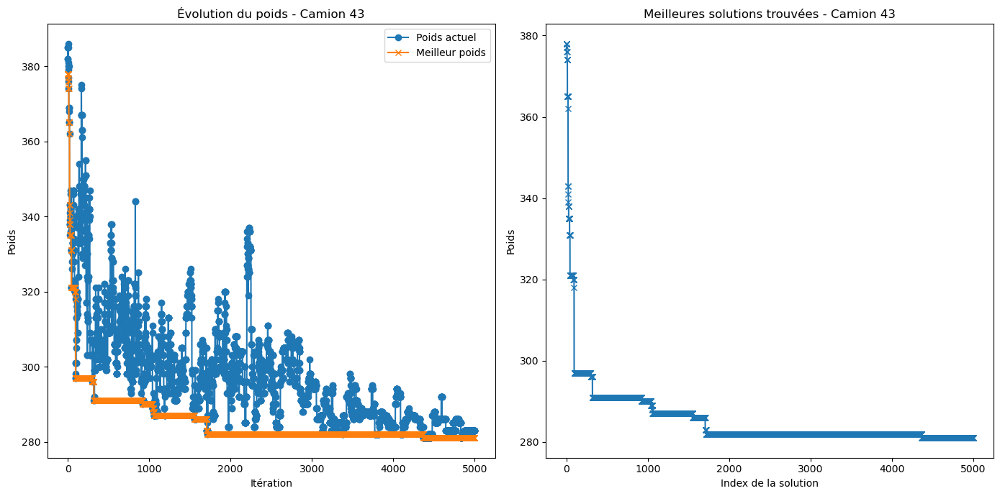

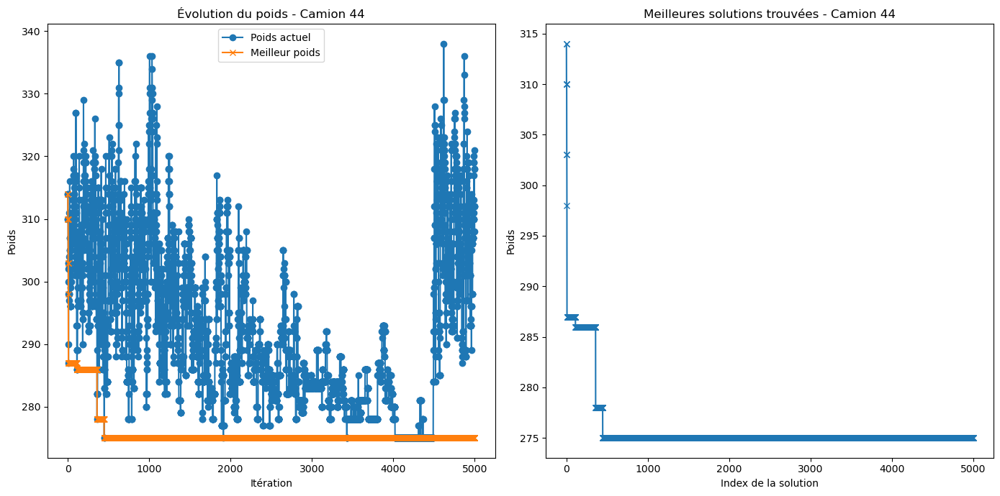

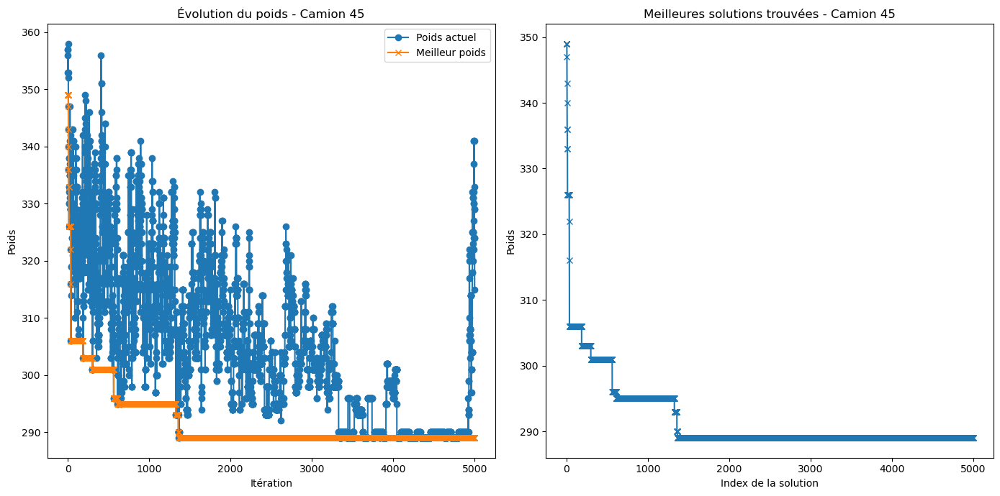

In [24]:
# Paramètres du problème
n = 5000
num_packages = 500
truck_capacity = 20  # Capacité des camions en m3
max_iterations = 5000

# Mesurer le temps d'exécution total du programme
total_start_time = time.time()
tracemalloc.start()

# Générer le graphe
G = generate_weighted_connected_graph(n)

# Pré-calculer les chemins de Dijkstra pour toutes les paires de nœuds
all_paths = dict(nx.all_pairs_dijkstra_path(G, weight='weight'))

# Calculer les plus courts chemins entre toutes les paires de nœuds
path_lengths = dict(nx.all_pairs_dijkstra_path_length(G, weight='weight'))

# Générer les colis et leurs volumes
packages = [(random.randint(0, n - 1), round(random.uniform(0.5, 3), 1)) for _ in range(num_packages)]
package_volumes = [round(vol, 1) for _, vol in packages]

# Afficher les informations sur les colis
print("Informations sur les colis :")
for i, (destination, volume) in enumerate(packages):
    print(f"Colis {i + 1} -> Destination: {destination}, Volume: {volume} m3")

# Ajuster les volumes pour le problème de sac à dos
scaled_volumes = [int(vol * 10) for vol in package_volumes]
scaled_capacity = int(truck_capacity * 10)

# Distribuer les colis dans les camions
trucks = distribute_packages(scaled_volumes, scaled_capacity)
truck_assignments = [[packages[i][0] for i in truck] for truck in trucks]


# Exécuter le recuit simulé pour chaque camion en parallèle
results = []
with concurrent.futures.ThreadPoolExecutor() as executor:
    futures = [executor.submit(optimize_path, points) for points in truck_assignments]
    results = [f.result() for f in futures]
    
# Mesurer la mémoire totale utilisée par le programme
total_mem_usage = tracemalloc.get_traced_memory()[1] / 1024  # Convert to KB
tracemalloc.stop()
total_exec_time = time.time() - total_start_time

# Extraire les résultats
all_paths, total_weights, all_iterations_data, times, memory_usages = zip(*results)

# Calcul de l'utilisation moyenne de la mémoire
avg_memory_usage = sum(memory_usages) / len(memory_usages)
total_path_weight = sum(total_weights)
weight_per_truck = total_path_weight / len(truck_assignments)

for i, (optimal_path, total_weight, iteration_data, exec_time, mem_usage) in enumerate(results):
    print(f"\nPoints de passage pour le camion {i + 1} : {truck_assignments[i]}")
    print(f"Chemin optimal pour le camion {i + 1} : {optimal_path}")
    print(f"Poids total du chemin pour le camion {i + 1} : {total_weight}")
    print(f"Temps de calcul : {exec_time:.4f} secondes")
    print(f"Utilisation de la mémoire : {mem_usage:.2f} Ko")
    
print(f"\nTemps d'exécution total du programme : {total_exec_time:.4f} secondes")
print(f"Utilisation moyenne de la mémoire : {avg_memory_usage:.2f} Ko")
print(f"Poids total de tous les chemins : {total_path_weight}")
print(f"Poids moyen par camion : {weight_per_truck}")

# Afficher le graphe avec les chemins optimaux
draw_weighted_graph(G, all_paths)

# Graphiques des mesures de performance
plt.figure(figsize=(14, 7))

plt.subplot(1, 3, 1)
plt.plot(range(1, len(truck_assignments) + 1), times, marker='o')
plt.title('Temps de calcul par camion')
plt.xlabel('Camion')
plt.ylabel('Temps (s)')

plt.subplot(1, 3, 2)
plt.plot(range(1, len(truck_assignments) + 1), memory_usages, marker='o')
plt.title('Utilisation de la mémoire par camion')
plt.xlabel('Camion')
plt.ylabel('Mémoire (Ko)')

plt.subplot(1, 3, 3)
plt.plot(range(1, len(truck_assignments) + 1), total_weights, marker='o')
plt.title('Poids total du chemin par camion')
plt.xlabel('Camion')
plt.ylabel('Poids total')

plt.tight_layout()
plt.show()

# Graphiques des itérations et des solutions
for i, iteration_data in enumerate(all_iterations_data):
    iterations, current_weights, best_weights = zip(*iteration_data)
    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(iterations, current_weights, marker='o', label='Poids actuel')
    plt.plot(iterations, best_weights, marker='x', label='Meilleur poids')
    plt.title(f'Évolution du poids - Camion {i + 1}')
    plt.xlabel('Itération')
    plt.ylabel('Poids')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(best_weights, marker='x')
    plt.title(f'Meilleures solutions trouvées - Camion {i + 1}')
    plt.xlabel('Index de la solution')
    plt.ylabel('Poids')

    plt.tight_layout()
    plt.show()

#### On relève ici nos 3 métriques : 
#### Temps d'exécution total du programme : 407.08 secondes. Ce temps commence à devenir problématique car c'est assez long. On remarque une très forte augmentation du temps d'exécution comparé au cas de test précédent. Cela est du a un nombre beacoup plus important de villes mais surtout d'itérations.
#### Utilisation moyenne de la mémoire : 102611,94 Ko. On remarque une très forte augmentation de celle ci comparé au cas précédent. Ce résultat reste très satisfaisant pour les tailles des paramêtres données mais peut commencer à devenir problématique.
#### Poids (distance) total de tous les chemins : 11691. Ce poids est cohérent (moyenne de 259,8 par camion). Le poids total a fortement augmenté car le nombre de villes a parcourir a fortement augmenté. Le poids moyen lui augmenté, mais cela reste cohérent avec les paramètres donnés. On a augmenté uniquement de 100 alors que on a quintuplé le nombre de villes et rajouté 2000 itérations.
#### Ce cas de test nous donne des résultats plus élévés que le cas précédent. On voit que quand on augmente encore fortement le nombre d'itération, les métriques de temps et de mémoire augmente exponentiellement. Ce cas peut être considéré comme début de cas limite. 

## Plan Expérimental

#### Passons maintenant à la partie étude expérimentalle. Nous allons prendre notre cas de test 3 et nous allons étudier son comportement en modifiant uniquement certain paramètres. 

#### On définie le graphe du cas de test 3 avec 1000 villes et on le garde tout en changeant nos autres paramètres.

In [38]:
# Paramètres du problème
n = 1000

# Générer le graphe
G = generate_weighted_connected_graph(n)


#### Ici, commençons par fixer le nombre de colis a 500

In [39]:
num_packages = 500
truck_capacity = 20  # Capacité des camions en m3

# Générer les colis et leurs volumes
packages = [(random.randint(0, n - 1), round(random.uniform(0.5, 3), 1)) for _ in range(num_packages)]
package_volumes = [round(vol, 1) for _, vol in packages]

# Afficher les informations sur les colis
print("Informations sur les colis :")
for i, (destination, volume) in enumerate(packages):
    print(f"Colis {i + 1} -> Destination: {destination}, Volume: {volume} m3")

# Ajuster les volumes pour le problème de sac à dos
scaled_volumes = [int(vol * 10) for vol in package_volumes]
scaled_capacity = int(truck_capacity * 10)

# Distribuer les colis dans les camions
trucks = distribute_packages(scaled_volumes, scaled_capacity)
truck_assignments = [[packages[i][0] for i in truck] for truck in trucks]

# Afficher la distribution des colis parmi les camions
print("\nDistribution des colis parmi les camions :")
for i, truck in enumerate(trucks):
    print(f"\nCamion {i + 1} transporte les colis suivants :")
    for j, volume in enumerate(truck):
        package_index = scaled_volumes.index(volume)
        destination = packages[package_index][0]
        original_volume = package_volumes[package_index]
        print(f"Colis -> Destination: {destination}, Volume: {original_volume} m3")

Informations sur les colis :
Colis 1 -> Destination: 574, Volume: 2.5 m3
Colis 2 -> Destination: 969, Volume: 1.0 m3
Colis 3 -> Destination: 596, Volume: 2.4 m3
Colis 4 -> Destination: 287, Volume: 1.9 m3
Colis 5 -> Destination: 426, Volume: 1.9 m3
Colis 6 -> Destination: 776, Volume: 3.0 m3
Colis 7 -> Destination: 703, Volume: 2.2 m3
Colis 8 -> Destination: 552, Volume: 1.3 m3
Colis 9 -> Destination: 898, Volume: 2.9 m3
Colis 10 -> Destination: 304, Volume: 1.4 m3
Colis 11 -> Destination: 176, Volume: 0.9 m3
Colis 12 -> Destination: 853, Volume: 1.6 m3
Colis 13 -> Destination: 805, Volume: 2.4 m3
Colis 14 -> Destination: 803, Volume: 1.8 m3
Colis 15 -> Destination: 848, Volume: 2.1 m3
Colis 16 -> Destination: 575, Volume: 0.6 m3
Colis 17 -> Destination: 235, Volume: 2.8 m3
Colis 18 -> Destination: 980, Volume: 2.0 m3
Colis 19 -> Destination: 675, Volume: 2.3 m3
Colis 20 -> Destination: 665, Volume: 2.0 m3
Colis 21 -> Destination: 714, Volume: 1.8 m3
Colis 22 -> Destination: 351, Volum


Distribution des colis parmi les camions :

Camion 1 transporte les colis suivants :
Colis -> Destination: 176, Volume: 0.9 m3
Colis -> Destination: 898, Volume: 2.9 m3
Colis -> Destination: 552, Volume: 1.3 m3
Colis -> Destination: 703, Volume: 2.2 m3
Colis -> Destination: 776, Volume: 3.0 m3
Colis -> Destination: 287, Volume: 1.9 m3
Colis -> Destination: 287, Volume: 1.9 m3
Colis -> Destination: 596, Volume: 2.4 m3
Colis -> Destination: 969, Volume: 1.0 m3
Colis -> Destination: 574, Volume: 2.5 m3

Camion 2 transporte les colis suivants :
Colis -> Destination: 351, Volume: 1.2 m3
Colis -> Destination: 803, Volume: 1.8 m3
Colis -> Destination: 675, Volume: 2.3 m3
Colis -> Destination: 980, Volume: 2.0 m3
Colis -> Destination: 235, Volume: 2.8 m3
Colis -> Destination: 575, Volume: 0.6 m3
Colis -> Destination: 848, Volume: 2.1 m3
Colis -> Destination: 803, Volume: 1.8 m3
Colis -> Destination: 596, Volume: 2.4 m3
Colis -> Destination: 853, Volume: 1.6 m3
Colis -> Destination: 304, Volum

#### Prenons pour commencer 200 itérations : 


Points de passage pour le camion 1 : [304, 844, 803, 593, 885, 665, 665, 587, 176, 267]
Chemin optimal pour le camion 1 : [0, 442, 441, 106, 629, 630, 304, 630, 631, 615, 176, 615, 59, 268, 267, 523, 276, 183, 587, 804, 803, 26, 25, 593, 592, 692, 840, 665, 664, 845, 844, 843, 752, 751, 261, 885, 886, 555, 637, 638, 0]
Distance totale du chemin pour le camion 1 : 40 km
Temps de calcul : 0.0072 secondes
Utilisation de la mémoire : 178061.60 Ko

Points de passage pour le camion 2 : [805, 675, 955, 714, 788, 703, 351, 675, 587, 235, 848]
Chemin optimal pour le camion 2 : [0, 814, 269, 863, 789, 788, 389, 390, 869, 674, 675, 183, 587, 183, 742, 741, 235, 410, 411, 972, 873, 872, 702, 703, 704, 111, 110, 920, 957, 956, 955, 954, 953, 471, 976, 71, 849, 848, 847, 846, 350, 351, 350, 714, 350, 559, 558, 806, 805, 17, 18, 814, 0]
Distance totale du chemin pour le camion 2 : 52 km
Temps de calcul : 0.0065 secondes
Utilisation de la mémoire : 5.04 Ko

Points de passage pour le camion 3 : [703, 

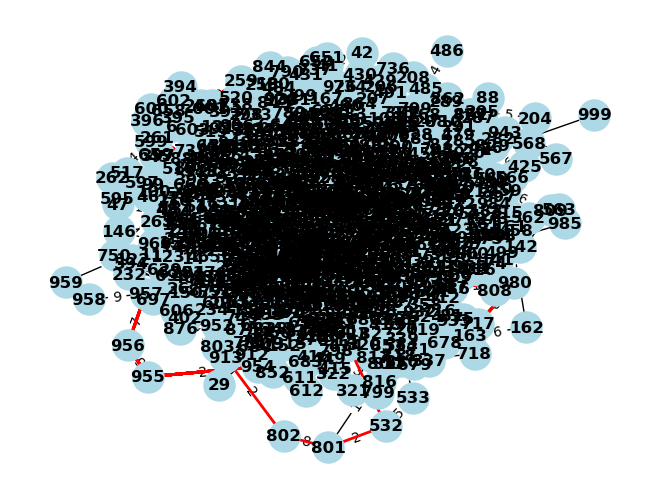

In [40]:
max_iterations = 200

# Pré-calculer les chemins de Dijkstra pour toutes les paires de nœuds
all_paths = dict(nx.all_pairs_dijkstra_path(G, weight='distance'))

# Calculer les plus courts chemins entre toutes les paires de nœuds
path_lengths = dict(nx.all_pairs_dijkstra_path_length(G, weight='distance'))

# Exécuter le recuit simulé pour chaque camion en parallèle
results = []
with concurrent.futures.ThreadPoolExecutor() as executor:
    futures = [executor.submit(optimize_path, points) for points in truck_assignments]
    results = [f.result() for f in futures]

# Extraire les résultats
all_paths, total_distances, all_iterations_data, times, memory_usages = zip(*results)

for i, (optimal_path, total_distance, iteration_data, exec_time, mem_usage) in enumerate(results):
    print(f"\nPoints de passage pour le camion {i + 1} : {truck_assignments[i]}")
    print(f"Chemin optimal pour le camion {i + 1} : {optimal_path}")
    print(f"Distance totale du chemin pour le camion {i + 1} : {total_distance} km")
    print(f"Temps de calcul : {exec_time:.4f} secondes")
    print(f"Utilisation de la mémoire : {mem_usage:.2f} Ko")

# Afficher le graphe avec les chemins optimaux
draw_weighted_graph(G, all_paths)

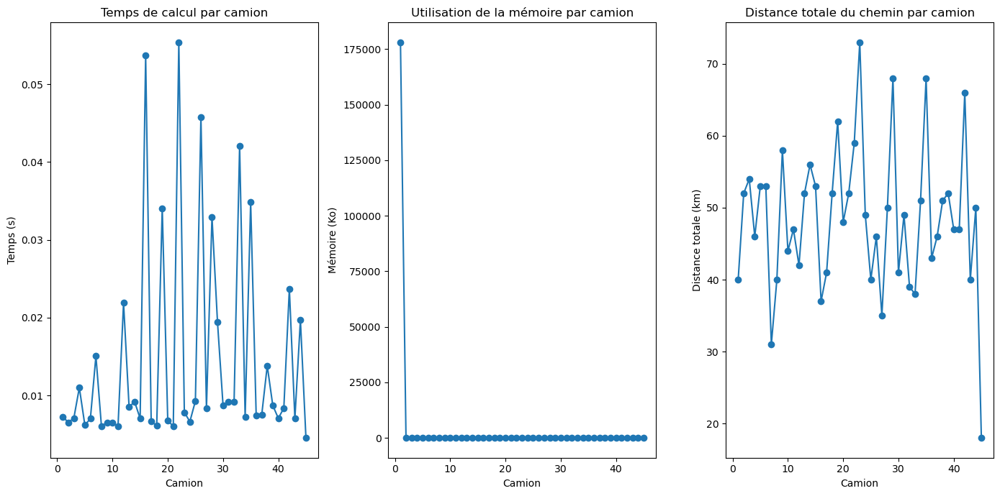

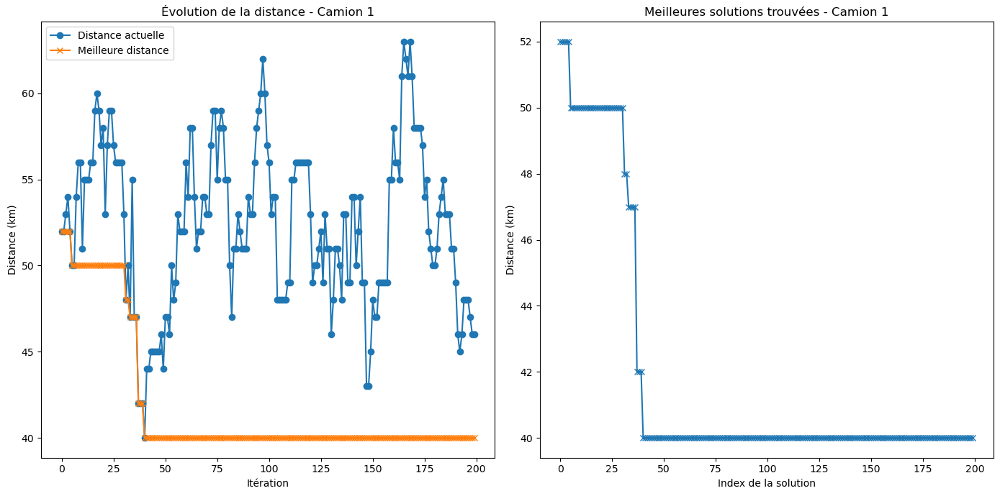

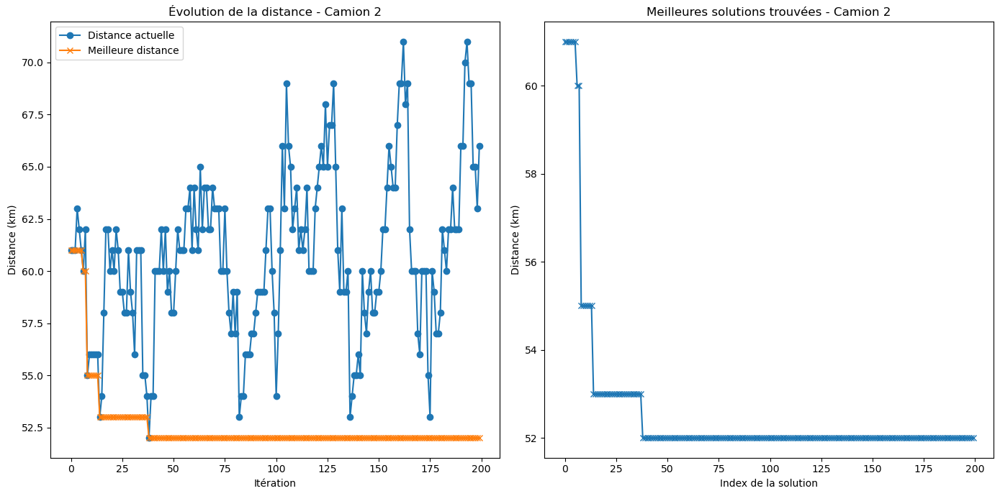

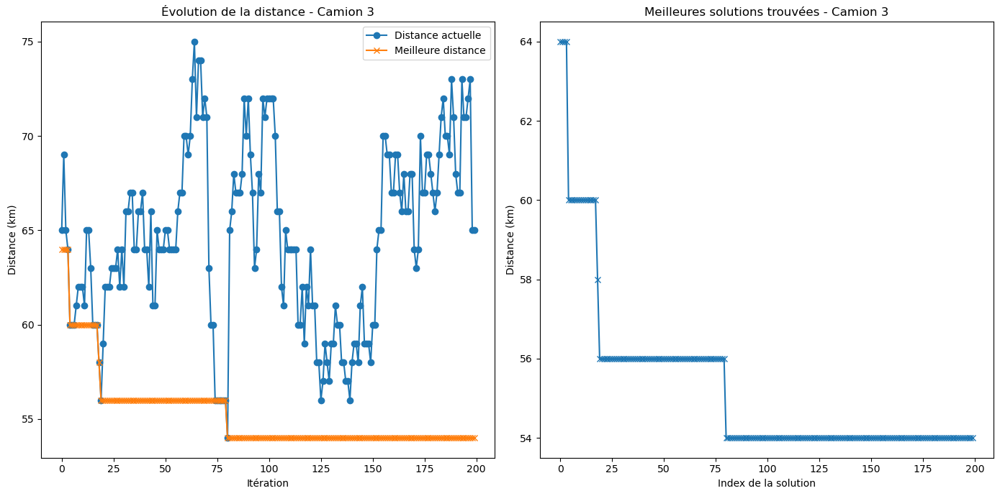

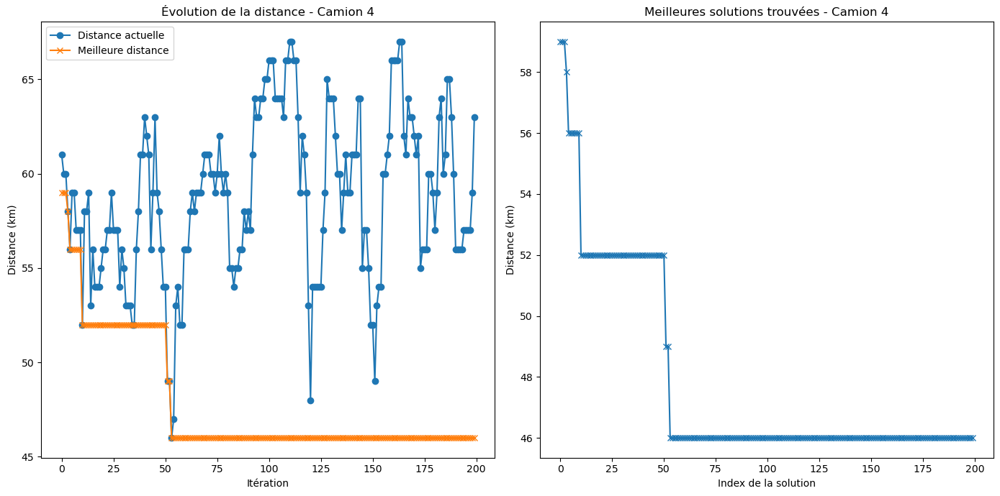

...

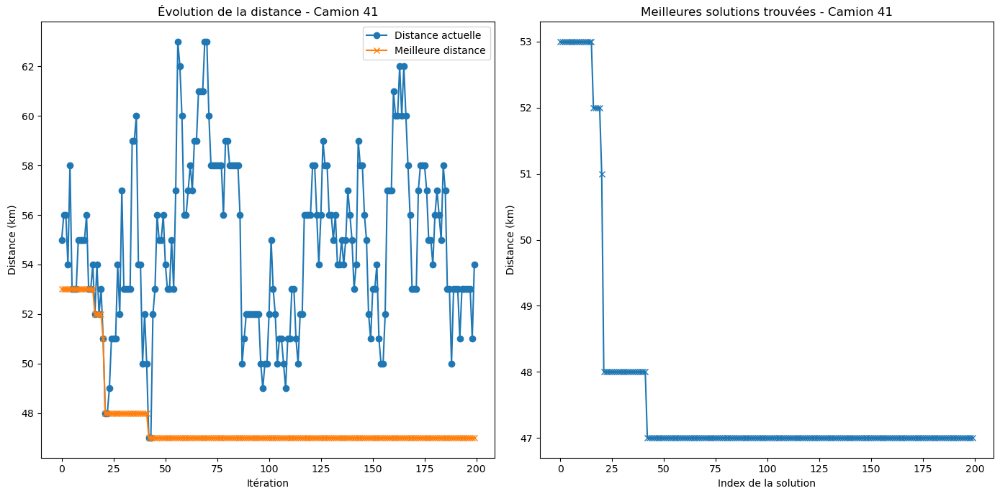

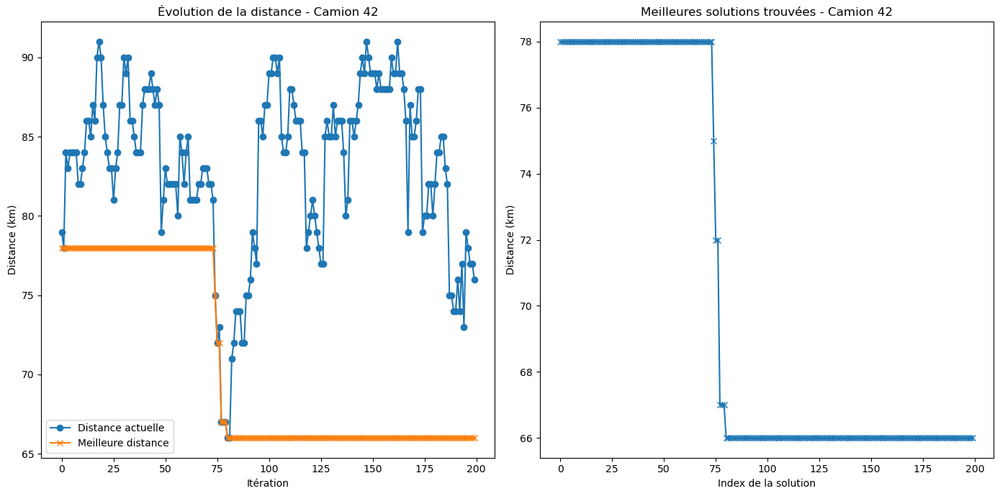

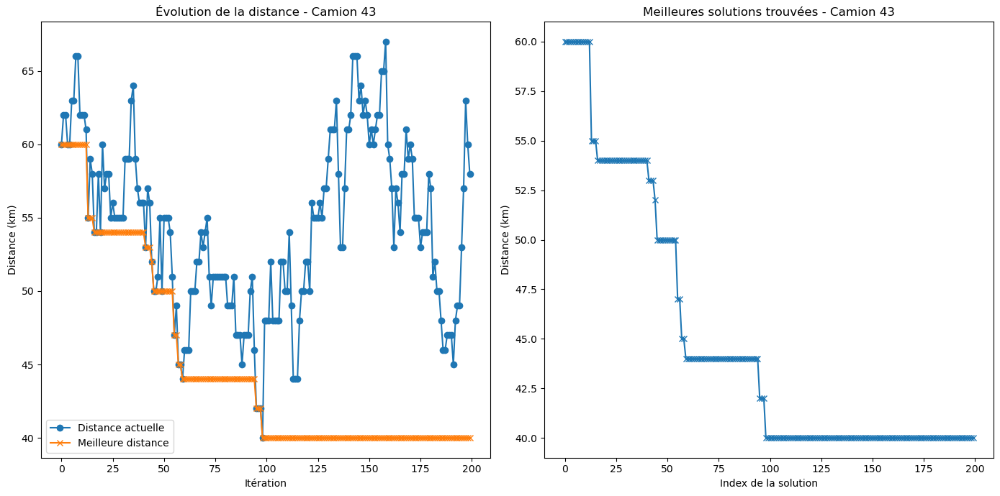

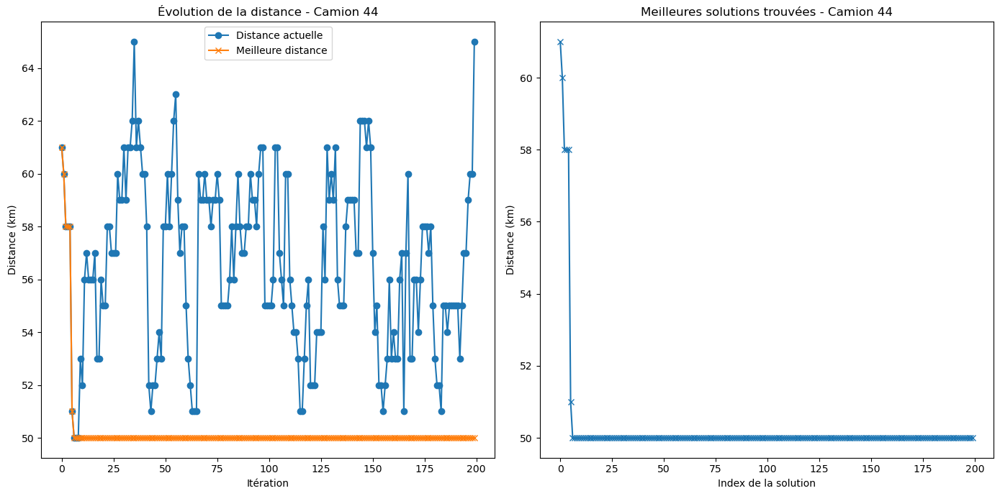

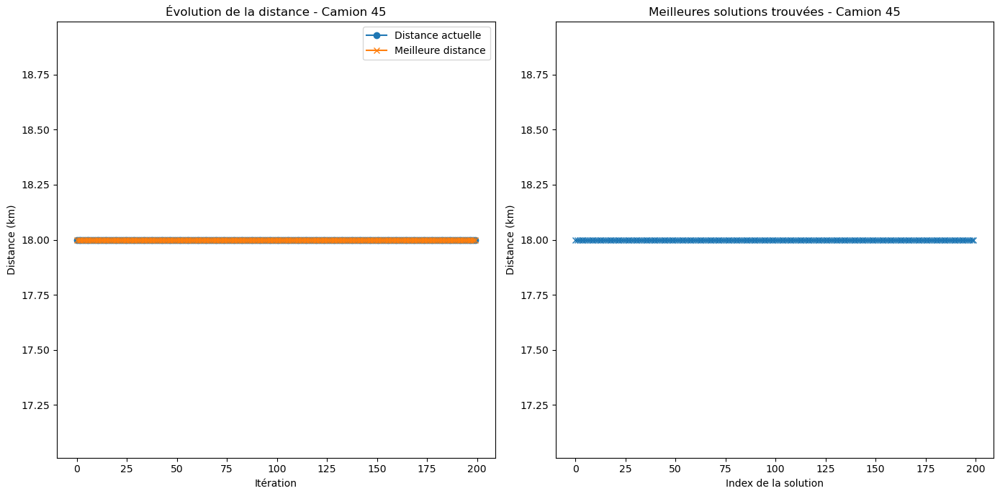


Statistiques:
Moyenne de la distance totale des chemins optimaux : 48.42 km
Écart type de la distance totale des chemins optimaux : 10.05 km
Temps total pris pour trouver les chemins optimaux : 0.65 secondes


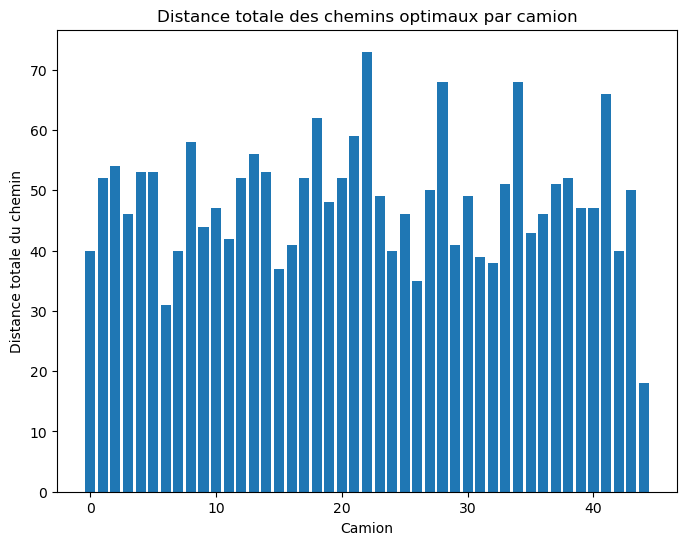

In [41]:
# Graphiques des mesures de performance
plt.figure(figsize=(14, 7))

plt.subplot(1, 3, 1)
plt.plot(range(1, len(truck_assignments) + 1), times, marker='o')
plt.title('Temps de calcul par camion')
plt.xlabel('Camion')
plt.ylabel('Temps (s)')

plt.subplot(1, 3, 2)
plt.plot(range(1, len(truck_assignments) + 1), memory_usages, marker='o')
plt.title('Utilisation de la mémoire par camion')
plt.xlabel('Camion')
plt.ylabel('Mémoire (Ko)')

plt.subplot(1, 3, 3)
plt.plot(range(1, len(truck_assignments) + 1), total_distances, marker='o')
plt.title('Distance totale du chemin par camion')
plt.xlabel('Camion')
plt.ylabel('Distance totale (km)')

plt.tight_layout()
plt.show()

# Graphiques des itérations et des solutions
for i, iteration_data in enumerate(all_iterations_data):
    iterations, current_distances, best_distances = zip(*iteration_data)
    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(iterations, current_distances, marker='o', label='Distance actuelle')
    plt.plot(iterations, best_distances, marker='x', label='Meilleure distance')
    plt.title(f'Évolution de la distance - Camion {i + 1}')
    plt.xlabel('Itération')
    plt.ylabel('Distance (km)')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(best_distances, marker='x')
    plt.title(f'Meilleures solutions trouvées - Camion {i + 1}')
    plt.xlabel('Index de la solution')
    plt.ylabel('Distance (km)')

    plt.tight_layout()
    plt.show()

# Calcul de la moyenne et de l'écart type de la distance totale des chemins optimaux pris par les camions
total_distance_mean = round(np.mean(total_distances),2)
total_distance_std = round(np.std(total_distances),2)

# Calcul du temps total pris pour trouver les chemins optimaux
total_time_taken = round(sum(times),2)

# Affichage des statistiques
print("\nStatistiques:")
print(f"Moyenne de la distance totale des chemins optimaux : {total_distance_mean} km")
print(f"Écart type de la distance totale des chemins optimaux : {total_distance_std} km")
print(f"Temps total pris pour trouver les chemins optimaux : {total_time_taken} secondes")

# Graphique pour la distance totale des chemins optimaux par camion
plt.figure(figsize=(8, 6))
plt.bar(range(len(truck_assignments)), total_distances)
plt.xlabel('Camion')
plt.ylabel('Distance totale du chemin')
plt.title('Distance totale des chemins optimaux par camion')
plt.show()

#### On peut voir que on obtient des résultats peu précis. On a 48.42 km pour la moyenne de la distance des chemins optimaux. 
#### L'écart type de la distance des chemins optimaux lui est de 10.05 km 
#### Le temps total lui est de 0.65sec, ce qui est quasiment instantané. 

#### Maintenant, augmentons le nombre d'itérations et regardons les changements.


Points de passage pour le camion 1 : [304, 844, 803, 593, 885, 665, 665, 587, 176, 267]
Chemin optimal pour le camion 1 : [0, 638, 637, 555, 886, 885, 261, 260, 259, 664, 665, 664, 845, 844, 845, 664, 665, 840, 692, 302, 303, 304, 303, 302, 692, 592, 593, 25, 26, 803, 804, 587, 183, 631, 615, 176, 615, 59, 268, 267, 268, 269, 814, 0]
Distance totale du chemin pour le camion 1 : 43 km
Temps de calcul : 0.0191 secondes
Utilisation de la mémoire : 37.70 Ko

Points de passage pour le camion 2 : [805, 675, 955, 714, 788, 703, 351, 675, 587, 235, 848]
Chemin optimal pour le camion 2 : [0, 638, 639, 370, 369, 847, 848, 849, 850, 412, 411, 410, 235, 741, 742, 183, 675, 183, 587, 804, 805, 17, 186, 187, 788, 389, 481, 937, 938, 954, 955, 956, 957, 920, 350, 351, 350, 714, 715, 128, 111, 704, 703, 704, 705, 492, 813, 814, 0]
Distance totale du chemin pour le camion 2 : 48 km
Temps de calcul : 0.0186 secondes
Utilisation de la mémoire : 56.62 Ko

Points de passage pour le camion 3 : [703, 351, 8

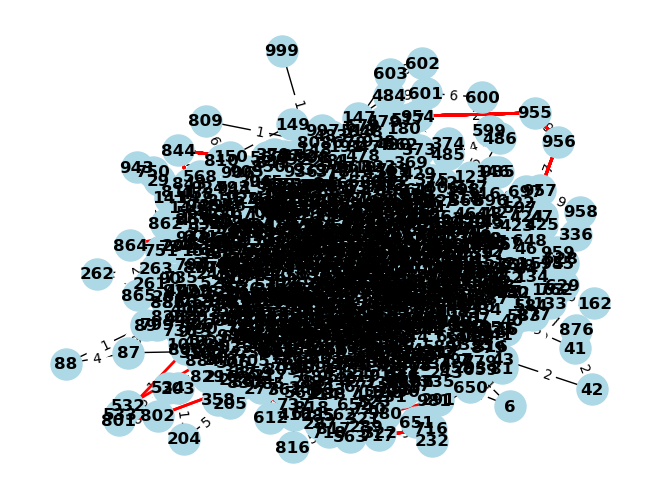

In [44]:
max_iterations = 600

# Pré-calculer les chemins de Dijkstra pour toutes les paires de nœuds
all_paths = dict(nx.all_pairs_dijkstra_path(G, weight='distance'))

# Calculer les plus courts chemins entre toutes les paires de nœuds
path_lengths = dict(nx.all_pairs_dijkstra_path_length(G, weight='distance'))

# Exécuter le recuit simulé pour chaque camion en parallèle
results = []
with concurrent.futures.ThreadPoolExecutor() as executor:
    futures = [executor.submit(optimize_path, points) for points in truck_assignments]
    results = [f.result() for f in futures]

# Extraire les résultats
all_paths, total_distances, all_iterations_data, times, memory_usages = zip(*results)

for i, (optimal_path, total_distance, iteration_data, exec_time, mem_usage) in enumerate(results):
    print(f"\nPoints de passage pour le camion {i + 1} : {truck_assignments[i]}")
    print(f"Chemin optimal pour le camion {i + 1} : {optimal_path}")
    print(f"Distance totale du chemin pour le camion {i + 1} : {total_distance} km")
    print(f"Temps de calcul : {exec_time:.4f} secondes")
    print(f"Utilisation de la mémoire : {mem_usage:.2f} Ko")

# Afficher le graphe avec les chemins optimaux
draw_weighted_graph(G, all_paths)

In [ ]:
# Graphiques des mesures de performance
plt.figure(figsize=(14, 7))

plt.subplot(1, 3, 1)
plt.plot(range(1, len(truck_assignments) + 1), times, marker='o')
plt.title('Temps de calcul par camion')
plt.xlabel('Camion')
plt.ylabel('Temps (s)')

plt.subplot(1, 3, 2)
plt.plot(range(1, len(truck_assignments) + 1), memory_usages, marker='o')
plt.title('Utilisation de la mémoire par camion')
plt.xlabel('Camion')
plt.ylabel('Mémoire (Ko)')

plt.subplot(1, 3, 3)
plt.plot(range(1, len(truck_assignments) + 1), total_distances, marker='o')
plt.title('Distance totale du chemin par camion')
plt.xlabel('Camion')
plt.ylabel('Distance totale (km)')

plt.tight_layout()
plt.show()

# Graphiques des itérations et des solutions
for i, iteration_data in enumerate(all_iterations_data):
    iterations, current_distances, best_distances = zip(*iteration_data)
    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(iterations, current_distances, marker='o', label='Distance actuelle')
    plt.plot(iterations, best_distances, marker='x', label='Meilleure distance')
    plt.title(f'Évolution de la distance - Camion {i + 1}')
    plt.xlabel('Itération')
    plt.ylabel('Distance (km)')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(best_distances, marker='x')
    plt.title(f'Meilleures solutions trouvées - Camion {i + 1}')
    plt.xlabel('Index de la solution')
    plt.ylabel('Distance (km)')

    plt.tight_layout()
    plt.show()

# Calcul de la moyenne et de l'écart type de la distance totale des chemins optimaux pris par les camions
total_distance_mean = round(np.mean(total_distances),2)
total_distance_std = round(np.std(total_distances),2)

# Calcul du temps total pris pour trouver les chemins optimaux
total_time_taken = round(sum(times),2)

# Affichage des statistiques
print("\nStatistiques:")
print(f"Moyenne de la distance totale des chemins optimaux : {total_distance_mean} km")
print(f"Écart type de la distance totale des chemins optimaux : {total_distance_std} km")
print(f"Temps total pris pour trouver les chemins optimaux : {total_time_taken} secondes")

# Graphique pour la distance totale des chemins optimaux par camion
plt.figure(figsize=(8, 6))
plt.bar(range(len(truck_assignments)), total_distances)
plt.xlabel('Camion')
plt.ylabel('Distance totale du chemin')
plt.title('Distance totale des chemins optimaux par camion')
plt.show()

#### On peut voir que, au prix d'un temps d'exécution plus lent, on diminue légèrement la moyenne de la distance des chemins optimaux (46.98 km) et on diminue l'écart à la moyenne (8.96km). 
#### On gagne en précision
#### Montons encore le nombre d'itérations et observons les résultats : 

Resetting temperature at iteration 6648

Points de passage pour le camion 1 : [304, 844, 803, 593, 885, 665, 665, 587, 176, 267]
Chemin optimal pour le camion 1 : [0, 613, 614, 615, 176, 615, 631, 630, 304, 630, 631, 183, 587, 804, 803, 26, 25, 593, 592, 692, 840, 665, 664, 845, 844, 843, 752, 751, 261, 885, 884, 883, 882, 267, 268, 269, 814, 0]
Distance totale du chemin pour le camion 1 : 37 km
Temps de calcul : 1.1746 secondes
Utilisation de la mémoire : 364.53 Ko

Points de passage pour le camion 2 : [805, 675, 955, 714, 788, 703, 351, 675, 587, 235, 848]
Chemin optimal pour le camion 2 : [0, 814, 18, 17, 805, 804, 587, 183, 675, 183, 742, 741, 235, 236, 237, 366, 508, 788, 508, 982, 112, 111, 704, 703, 704, 705, 706, 300, 849, 848, 847, 846, 350, 351, 350, 714, 350, 920, 957, 956, 955, 954, 938, 937, 572, 442, 0]
Distance totale du chemin pour le camion 2 : 46 km
Temps de calcul : 1.0404 secondes
Utilisation de la mémoire : 3225.96 Ko

Points de passage pour le camion 3 : [703, 351

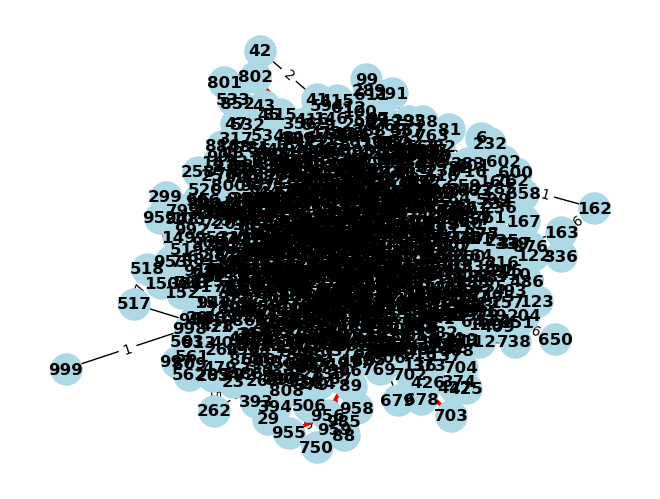

In [54]:
max_iterations = 7000

# Pré-calculer les chemins de Dijkstra pour toutes les paires de nœuds
all_paths = dict(nx.all_pairs_dijkstra_path(G, weight='distance'))

# Calculer les plus courts chemins entre toutes les paires de nœuds
path_lengths = dict(nx.all_pairs_dijkstra_path_length(G, weight='distance'))

# Exécuter le recuit simulé pour chaque camion en parallèle
results = []
with concurrent.futures.ThreadPoolExecutor() as executor:
    futures = [executor.submit(optimize_path, points) for points in truck_assignments]
    results = [f.result() for f in futures]

# Extraire les résultats
all_paths, total_distances, all_iterations_data, times, memory_usages = zip(*results)

for i, (optimal_path, total_distance, iteration_data, exec_time, mem_usage) in enumerate(results):
    print(f"\nPoints de passage pour le camion {i + 1} : {truck_assignments[i]}")
    print(f"Chemin optimal pour le camion {i + 1} : {optimal_path}")
    print(f"Distance totale du chemin pour le camion {i + 1} : {total_distance} km")
    print(f"Temps de calcul : {exec_time:.4f} secondes")
    print(f"Utilisation de la mémoire : {mem_usage:.2f} Ko")

# Afficher le graphe avec les chemins optimaux
draw_weighted_graph(G, all_paths)

In [ ]:
# Graphiques des mesures de performance
plt.figure(figsize=(14, 7))

plt.subplot(1, 3, 1)
plt.plot(range(1, len(truck_assignments) + 1), times, marker='o')
plt.title('Temps de calcul par camion')
plt.xlabel('Camion')
plt.ylabel('Temps (s)')

plt.subplot(1, 3, 2)
plt.plot(range(1, len(truck_assignments) + 1), memory_usages, marker='o')
plt.title('Utilisation de la mémoire par camion')
plt.xlabel('Camion')
plt.ylabel('Mémoire (Ko)')

plt.subplot(1, 3, 3)
plt.plot(range(1, len(truck_assignments) + 1), total_distances, marker='o')
plt.title('Distance totale du chemin par camion')
plt.xlabel('Camion')
plt.ylabel('Distance totale (km)')

plt.tight_layout()
plt.show()

# Graphiques des itérations et des solutions
for i, iteration_data in enumerate(all_iterations_data):
    iterations, current_distances, best_distances = zip(*iteration_data)
    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(iterations, current_distances, marker='o', label='Distance actuelle')
    plt.plot(iterations, best_distances, marker='x', label='Meilleure distance')
    plt.title(f'Évolution de la distance - Camion {i + 1}')
    plt.xlabel('Itération')
    plt.ylabel('Distance (km)')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(best_distances, marker='x')
    plt.title(f'Meilleures solutions trouvées - Camion {i + 1}')
    plt.xlabel('Index de la solution')
    plt.ylabel('Distance (km)')

    plt.tight_layout()
    plt.show()

# Calcul de la moyenne et de l'écart type de la distance totale des chemins optimaux pris par les camions
total_distance_mean = round(np.mean(total_distances),2)
total_distance_std = round(np.std(total_distances),2)

# Calcul du temps total pris pour trouver les chemins optimaux
total_time_taken = round(sum(times),2)

# Affichage des statistiques
print("\nStatistiques:")
print(f"Moyenne de la distance totale des chemins optimaux : {total_distance_mean} km")
print(f"Écart type de la distance totale des chemins optimaux : {total_distance_std} km")
print(f"Temps total pris pour trouver les chemins optimaux : {total_time_taken} secondes")

# Graphique pour la distance totale des chemins optimaux par camion
plt.figure(figsize=(8, 6))
plt.bar(range(len(truck_assignments)), total_distances)
plt.xlabel('Camion')
plt.ylabel('Distance totale du chemin')
plt.title('Distance totale des chemins optimaux par camion')
plt.show()

#### En multipliant par plus de 10 le nombre d'itérations, on arrive encore à améliorer notre solution. 
#### On diminue la moyenne de la distance des chemins (41.49km)
#### L'écart à la moyenne diminue aussi (7.28km), ce qui prouve que les résultat sont moins dispersés et donc plus précis. 
#### On perd par contre en rapidité (105 sec de temps total)
#### On peut aussi comparer l'utilisations mémoire, qui augmente de plus en plus quand on augmente le nombre d'itération (voir graphique). 
#### Cette étude nous montre que plus le nombre d'éxécution est faible, plus l'algorithme sera rapide et moins il sera précis, optimisé et gourmand en mémoire. A l'inverse, plus le nombre d'éxécution est grand, plus l'algorithme devient précis et optimisé, mais il devient plus gourmand en mémoire et aussi plus lent. 

#### Maintenant faisons varier le nombre de colis tout en fixant le nombre d'itération à 7000 pour voir si en baissant notre nombre de colis, nous pouvons encore optimiser notre distance. 

In [56]:
num_packages = 100
truck_capacity = 20  # Capacité des camions en m3

# Générer les colis et leurs volumes
packages = [(random.randint(0, n - 1), round(random.uniform(0.5, 3), 1)) for _ in range(num_packages)]
package_volumes = [round(vol, 1) for _, vol in packages]

# Afficher les informations sur les colis
print("Informations sur les colis :")
for i, (destination, volume) in enumerate(packages):
    print(f"Colis {i + 1} -> Destination: {destination}, Volume: {volume} m3")

# Ajuster les volumes pour le problème de sac à dos
scaled_volumes = [int(vol * 10) for vol in package_volumes]
scaled_capacity = int(truck_capacity * 10)

# Distribuer les colis dans les camions
trucks = distribute_packages(scaled_volumes, scaled_capacity)
truck_assignments = [[packages[i][0] for i in truck] for truck in trucks]

# Afficher la distribution des colis parmi les camions
print("\nDistribution des colis parmi les camions :")
for i, truck in enumerate(trucks):
    print(f"\nCamion {i + 1} transporte les colis suivants :")
    for j, volume in enumerate(truck):
        package_index = scaled_volumes.index(volume)
        destination = packages[package_index][0]
        original_volume = package_volumes[package_index]
        print(f"Colis -> Destination: {destination}, Volume: {original_volume} m3")

Informations sur les colis :
Colis 1 -> Destination: 591, Volume: 2.8 m3
Colis 2 -> Destination: 767, Volume: 1.6 m3
Colis 3 -> Destination: 731, Volume: 1.3 m3
Colis 4 -> Destination: 875, Volume: 0.5 m3
Colis 5 -> Destination: 76, Volume: 2.0 m3
Colis 6 -> Destination: 284, Volume: 0.7 m3
Colis 7 -> Destination: 151, Volume: 2.7 m3
Colis 8 -> Destination: 259, Volume: 1.3 m3
Colis 9 -> Destination: 11, Volume: 1.0 m3
Colis 10 -> Destination: 658, Volume: 1.7 m3
Colis 11 -> Destination: 758, Volume: 2.5 m3
Colis 12 -> Destination: 147, Volume: 2.4 m3
Colis 13 -> Destination: 308, Volume: 3.0 m3
Colis 14 -> Destination: 300, Volume: 2.6 m3
Colis 15 -> Destination: 816, Volume: 2.0 m3
Colis 16 -> Destination: 746, Volume: 1.7 m3
Colis 17 -> Destination: 837, Volume: 1.4 m3
Colis 18 -> Destination: 665, Volume: 1.7 m3
Colis 19 -> Destination: 365, Volume: 1.8 m3
Colis 20 -> Destination: 902, Volume: 1.5 m3
Colis 21 -> Destination: 300, Volume: 0.9 m3
Colis 22 -> Destination: 214, Volume:


Points de passage pour le camion 1 : [795, 643, 665, 758, 300, 855, 259, 300, 300, 837, 979]
Chemin optimal pour le camion 1 : [0, 814, 855, 978, 979, 622, 78, 645, 644, 643, 642, 641, 873, 523, 837, 838, 839, 840, 665, 664, 259, 258, 257, 794, 795, 796, 851, 850, 849, 300, 849, 213, 757, 758, 908, 907, 442, 0]
Distance totale du chemin pour le camion 1 : 37 km
Temps de calcul : 0.7675 secondes
Utilisation de la mémoire : 2377.65 Ko

Points de passage pour le camion 2 : [235, 643, 746, 365, 816, 665, 300, 89, 235, 284]
Chemin optimal pour le camion 2 : [0, 1, 728, 729, 504, 505, 89, 90, 671, 670, 476, 475, 643, 642, 904, 667, 746, 667, 666, 665, 666, 194, 193, 284, 283, 911, 36, 301, 300, 849, 213, 365, 366, 237, 236, 235, 236, 322, 321, 320, 817, 816, 815, 814, 0]
Distance totale du chemin pour le camion 2 : 44 km
Temps de calcul : 0.9295 secondes
Utilisation de la mémoire : 0.00 Ko

Points de passage pour le camion 3 : [214, 758, 795, 658, 973, 902, 324, 324, 758, 151, 259, 658, 665

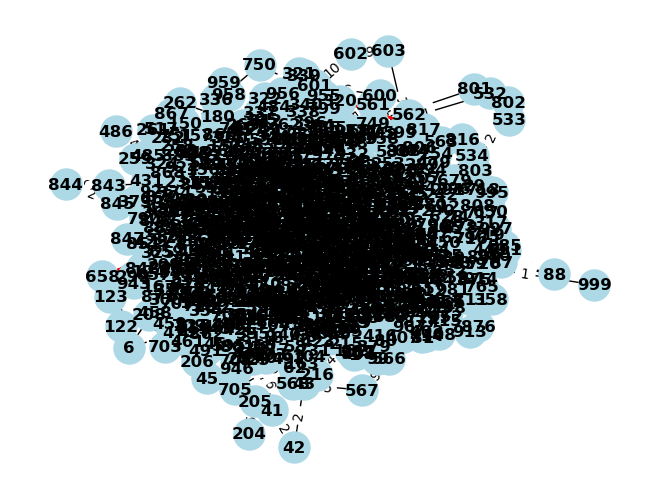

In [59]:
max_iterations = 7000

# Pré-calculer les chemins de Dijkstra pour toutes les paires de nœuds
all_paths = dict(nx.all_pairs_dijkstra_path(G, weight='distance'))

# Calculer les plus courts chemins entre toutes les paires de nœuds
path_lengths = dict(nx.all_pairs_dijkstra_path_length(G, weight='distance'))

# Exécuter le recuit simulé pour chaque camion en parallèle
results = []
with concurrent.futures.ThreadPoolExecutor() as executor:
    futures = [executor.submit(optimize_path, points) for points in truck_assignments]
    results = [f.result() for f in futures]

# Extraire les résultats
all_paths, total_distances, all_iterations_data, times, memory_usages = zip(*results)

for i, (optimal_path, total_distance, iteration_data, exec_time, mem_usage) in enumerate(results):
    print(f"\nPoints de passage pour le camion {i + 1} : {truck_assignments[i]}")
    print(f"Chemin optimal pour le camion {i + 1} : {optimal_path}")
    print(f"Distance totale du chemin pour le camion {i + 1} : {total_distance} km")
    print(f"Temps de calcul : {exec_time:.4f} secondes")
    print(f"Utilisation de la mémoire : {mem_usage:.2f} Ko")

# Afficher le graphe avec les chemins optimaux
draw_weighted_graph(G, all_paths)

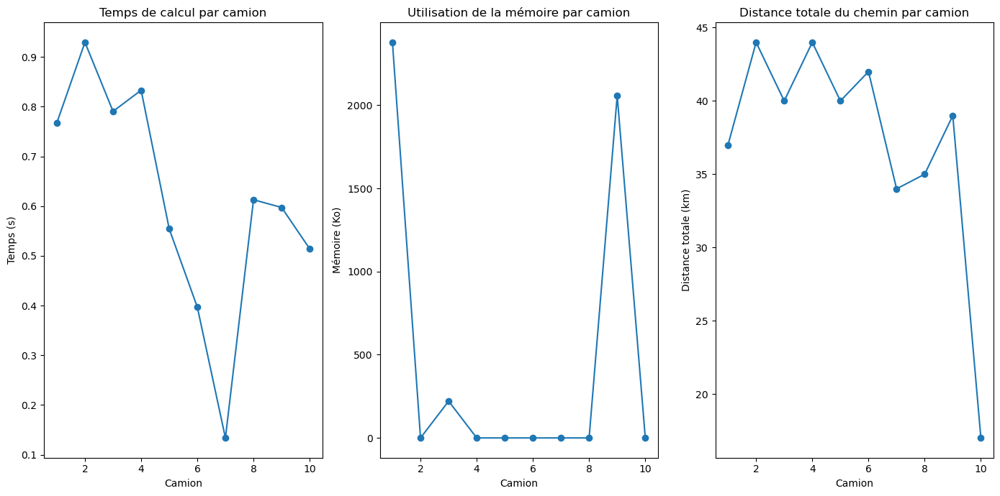

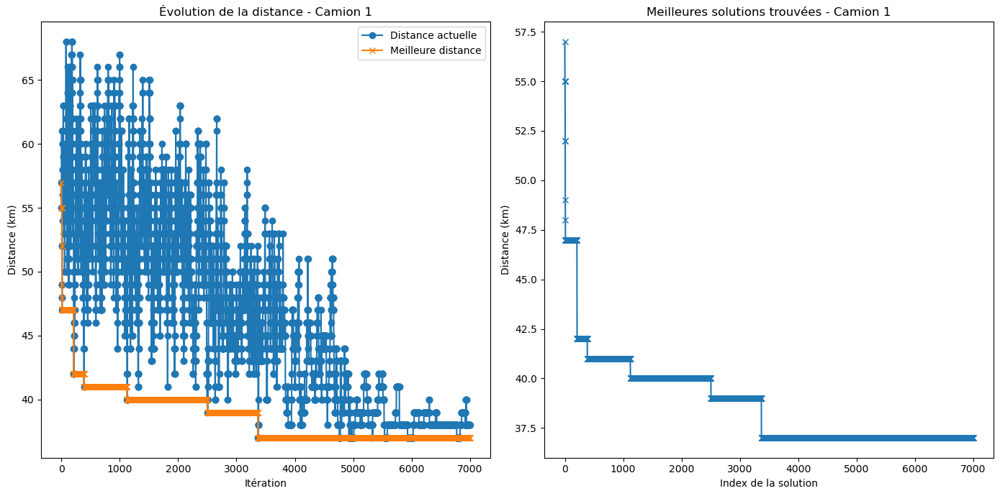

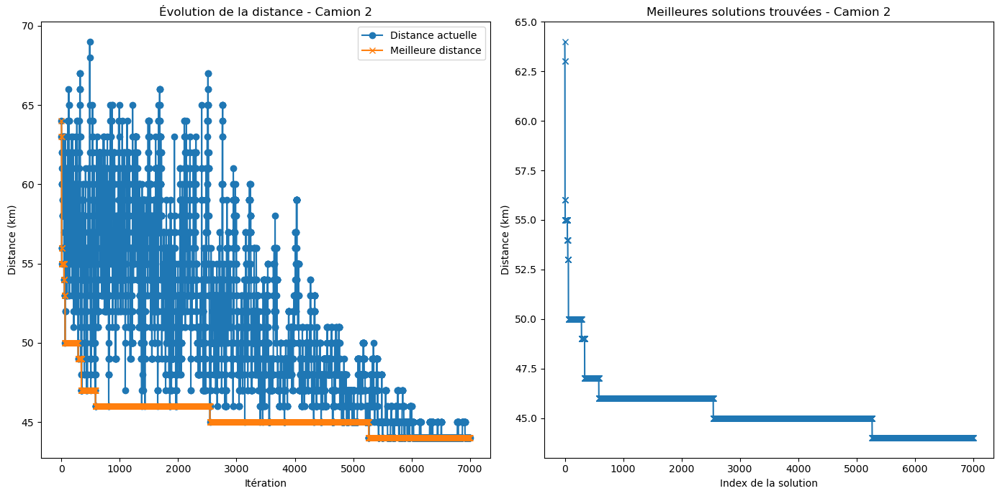

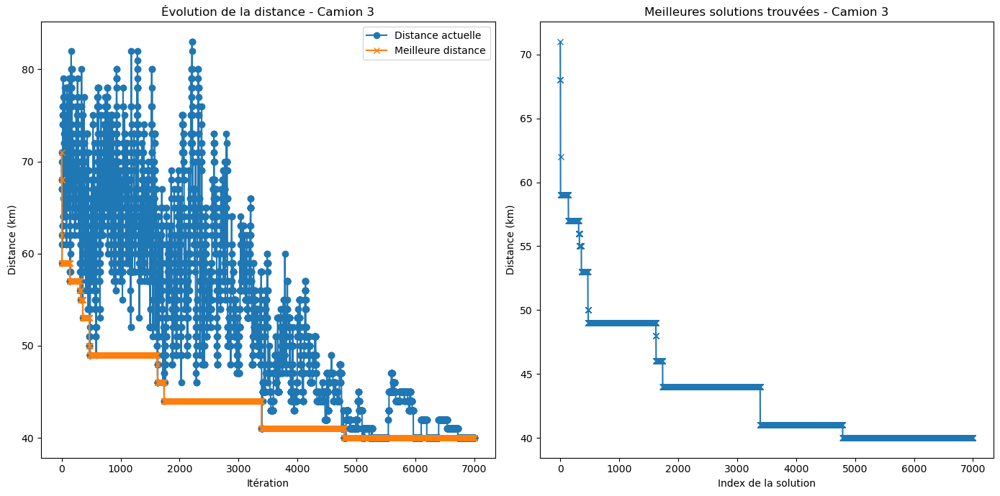

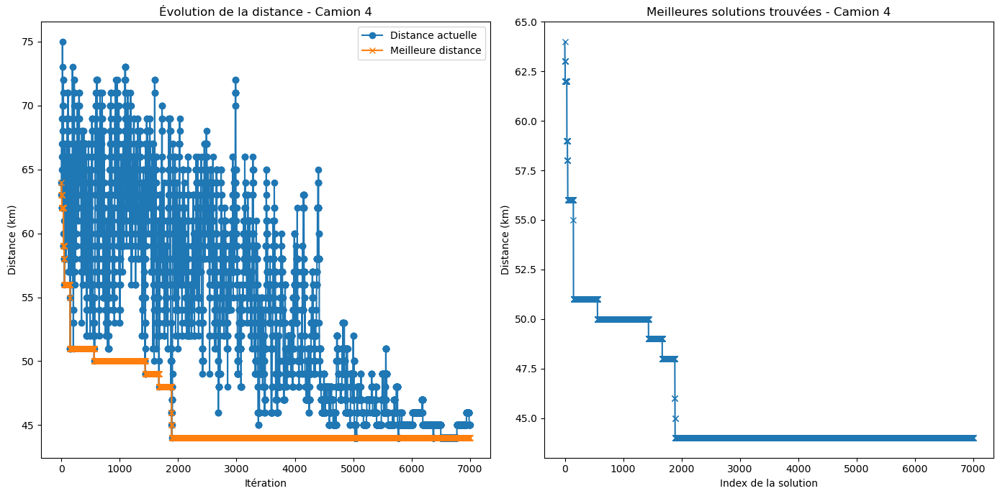

...

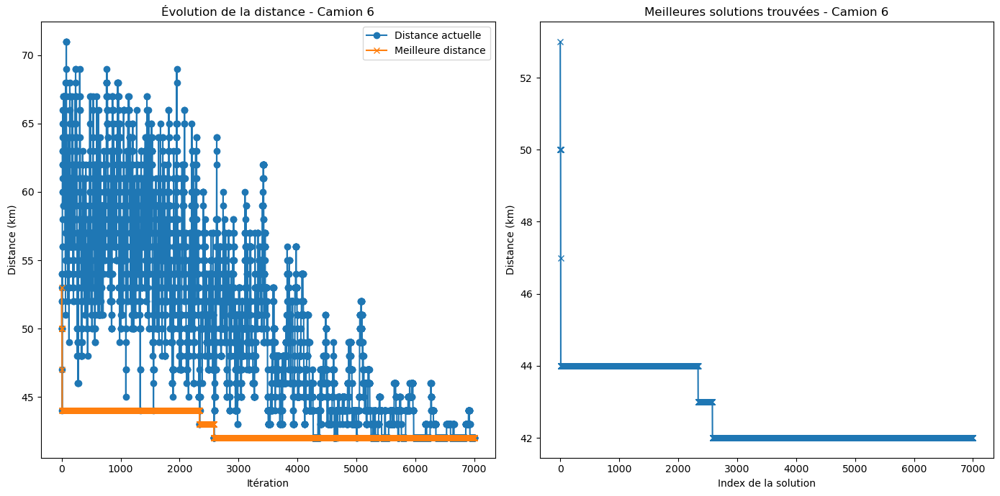

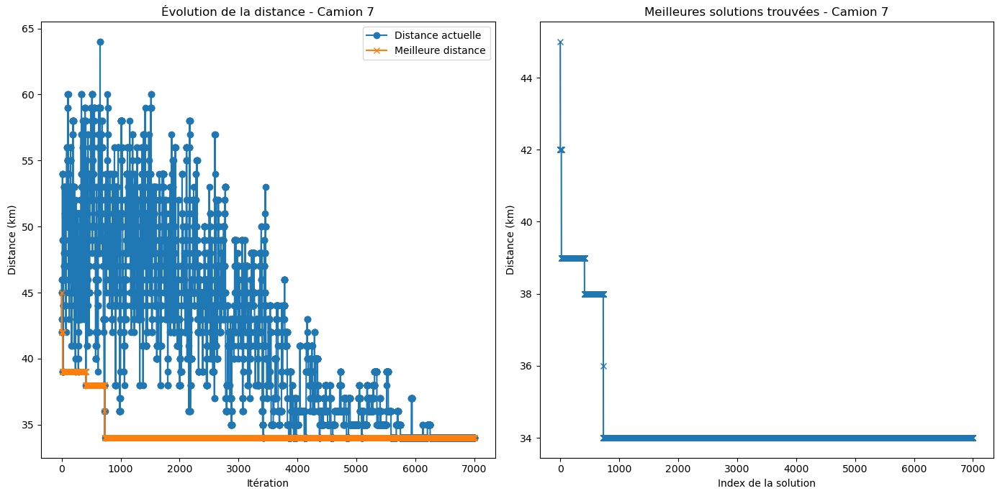

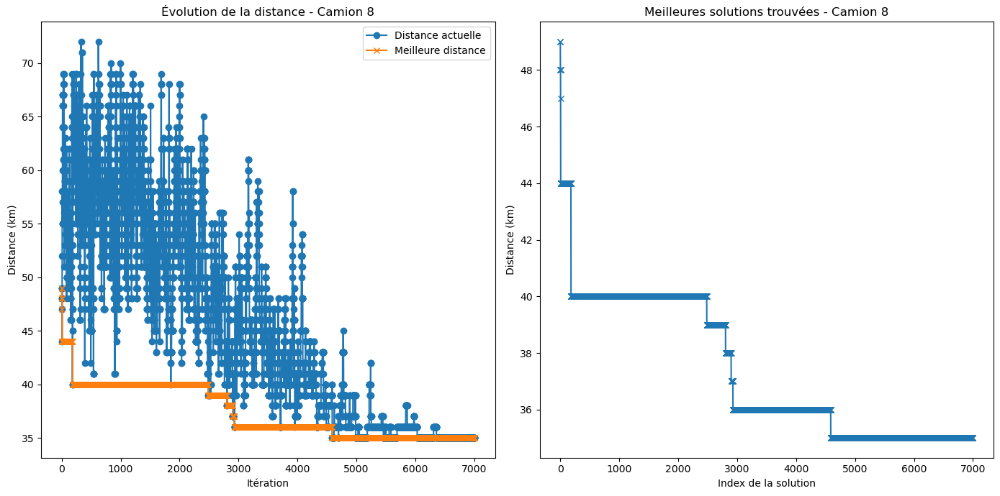

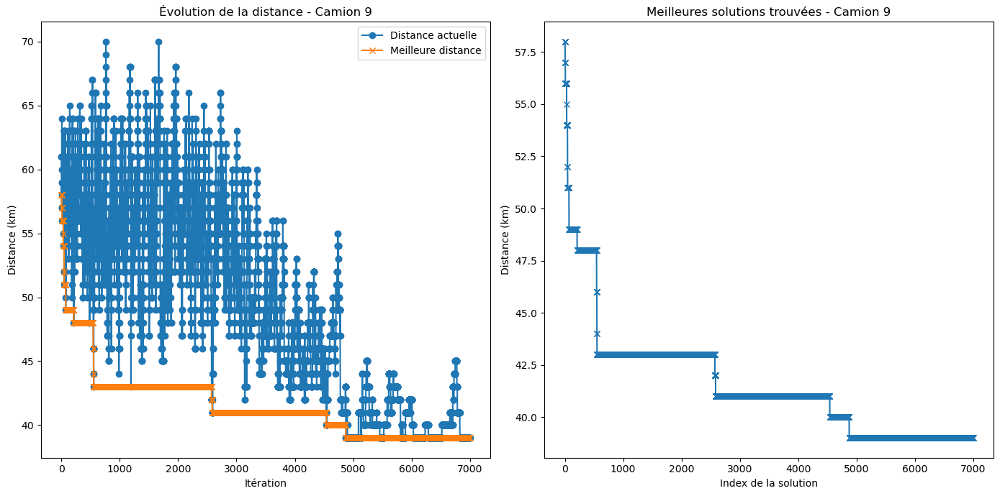

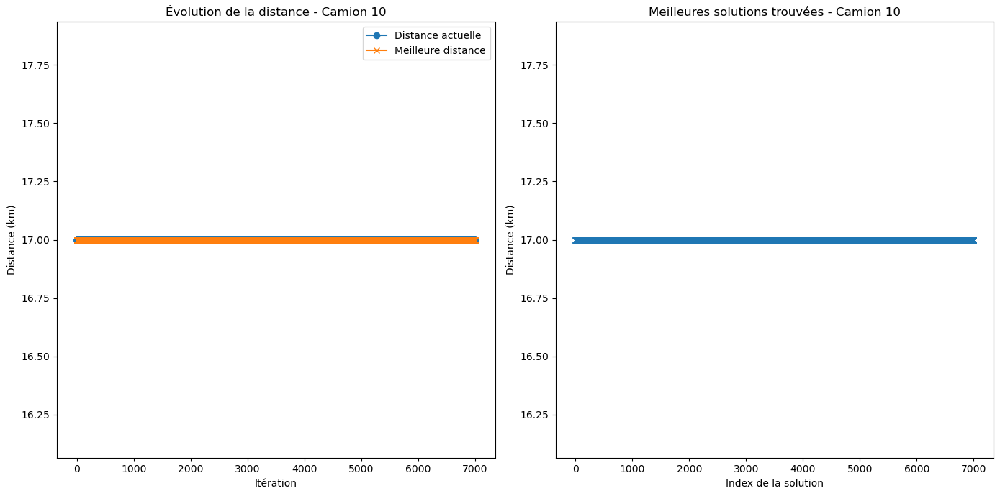


Statistiques:
Moyenne de la distance totale des chemins optimaux : 37.2 km
Écart type de la distance totale des chemins optimaux : 7.47 km
Temps total pris pour trouver les chemins optimaux : 6.13 secondes


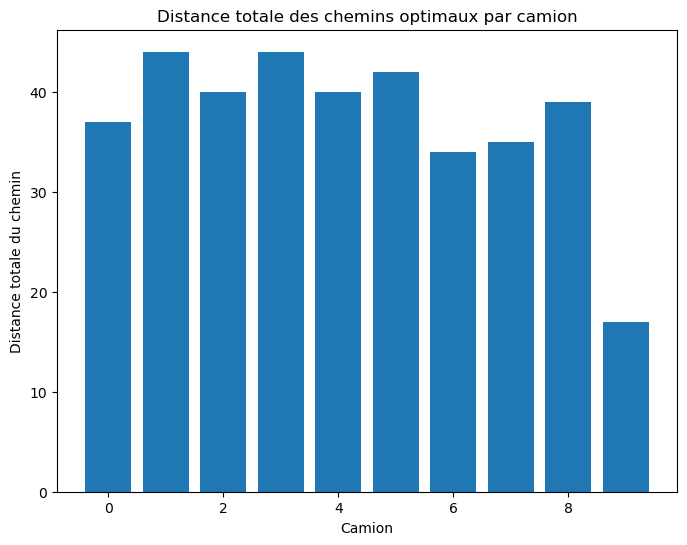

In [60]:
# Graphiques des mesures de performance
plt.figure(figsize=(14, 7))

plt.subplot(1, 3, 1)
plt.plot(range(1, len(truck_assignments) + 1), times, marker='o')
plt.title('Temps de calcul par camion')
plt.xlabel('Camion')
plt.ylabel('Temps (s)')

plt.subplot(1, 3, 2)
plt.plot(range(1, len(truck_assignments) + 1), memory_usages, marker='o')
plt.title('Utilisation de la mémoire par camion')
plt.xlabel('Camion')
plt.ylabel('Mémoire (Ko)')

plt.subplot(1, 3, 3)
plt.plot(range(1, len(truck_assignments) + 1), total_distances, marker='o')
plt.title('Distance totale du chemin par camion')
plt.xlabel('Camion')
plt.ylabel('Distance totale (km)')

plt.tight_layout()
plt.show()

# Graphiques des itérations et des solutions
for i, iteration_data in enumerate(all_iterations_data):
    iterations, current_distances, best_distances = zip(*iteration_data)
    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(iterations, current_distances, marker='o', label='Distance actuelle')
    plt.plot(iterations, best_distances, marker='x', label='Meilleure distance')
    plt.title(f'Évolution de la distance - Camion {i + 1}')
    plt.xlabel('Itération')
    plt.ylabel('Distance (km)')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(best_distances, marker='x')
    plt.title(f'Meilleures solutions trouvées - Camion {i + 1}')
    plt.xlabel('Index de la solution')
    plt.ylabel('Distance (km)')

    plt.tight_layout()
    plt.show()

# Calcul de la moyenne et de l'écart type de la distance totale des chemins optimaux pris par les camions
total_distance_mean = round(np.mean(total_distances),2)
total_distance_std = round(np.std(total_distances),2)

# Calcul du temps total pris pour trouver les chemins optimaux
total_time_taken = round(sum(times),2)

# Affichage des statistiques
print("\nStatistiques:")
print(f"Moyenne de la distance totale des chemins optimaux : {total_distance_mean} km")
print(f"Écart type de la distance totale des chemins optimaux : {total_distance_std} km")
print(f"Temps total pris pour trouver les chemins optimaux : {total_time_taken} secondes")

# Graphique pour la distance totale des chemins optimaux par camion
plt.figure(figsize=(8, 6))
plt.bar(range(len(truck_assignments)), total_distances)
plt.xlabel('Camion')
plt.ylabel('Distance totale du chemin')
plt.title('Distance totale des chemins optimaux par camion')
plt.show()

#### On remarque qu'en divisant par 5 notre nombre de colis, on arrive encore à optimiser notre solution. 
#### On gagne environ 4 km sur notre moyenne de distance (41km -> 37km). Nos camions font moins de routes, nous sommes plus écologiques. 
#### Notre écart à la moyenne lui augmente légèrement (7.28km -> 7.48km), ce qui veut dire que nous sommes un peu moins précis mais cette augmentation est négligeable comparé à la distance gagnée
#### On gagne cependant en vitesse d'éxécution (105 sec -> 6 sec)
#### Ces changements sont due au faites que le nombre de camions est liés au nombre de colis, plus il y a de colis, plus on a besoin de camion et inversement. Ce qui fait que, pour le meme nombre d'itération, on diminue le nombre de colis, on réduit le nombre de camion, ce qui a pour effet de réduire la distance parcourue et gagner en vitesse d'éxecution vu qu'il y a moins de camions à traiter.
#### Pour prouver mon point, augmentons le nombres de colis :

In [ ]:
num_packages = 1000
truck_capacity = 20  # Capacité des camions en m3

# Générer les colis et leurs volumes
packages = [(random.randint(0, n - 1), round(random.uniform(0.5, 3), 1)) for _ in range(num_packages)]
package_volumes = [round(vol, 1) for _, vol in packages]

# Afficher les informations sur les colis
print("Informations sur les colis :")
for i, (destination, volume) in enumerate(packages):
    print(f"Colis {i + 1} -> Destination: {destination}, Volume: {volume} m3")

# Ajuster les volumes pour le problème de sac à dos
scaled_volumes = [int(vol * 10) for vol in package_volumes]
scaled_capacity = int(truck_capacity * 10)

# Distribuer les colis dans les camions
trucks = distribute_packages(scaled_volumes, scaled_capacity)
truck_assignments = [[packages[i][0] for i in truck] for truck in trucks]

# Afficher la distribution des colis parmi les camions
print("\nDistribution des colis parmi les camions :")
for i, truck in enumerate(trucks):
    print(f"\nCamion {i + 1} transporte les colis suivants :")
    for j, volume in enumerate(truck):
        package_index = scaled_volumes.index(volume)
        destination = packages[package_index][0]
        original_volume = package_volumes[package_index]
        print(f"Colis -> Destination: {destination}, Volume: {original_volume} m3")


Distribution des colis parmi les camions :

Camion 1 transporte les colis suivants :
Colis -> Destination: 292, Volume: 1.0 m3
Colis -> Destination: 971, Volume: 2.8 m3
Colis -> Destination: 687, Volume: 2.4 m3
Colis -> Destination: 115, Volume: 2.5 m3
Colis -> Destination: 359, Volume: 3.0 m3
Colis -> Destination: 587, Volume: 2.1 m3
Colis -> Destination: 951, Volume: 0.9 m3
Colis -> Destination: 158, Volume: 1.4 m3
Colis -> Destination: 484, Volume: 1.5 m3
Colis -> Destination: 292, Volume: 1.0 m3
Colis -> Destination: 158, Volume: 1.4 m3

Camion 2 transporte les colis suivants :
Colis -> Destination: 158, Volume: 1.4 m3
Colis -> Destination: 320, Volume: 2.6 m3
Colis -> Destination: 158, Volume: 1.4 m3
Colis -> Destination: 704, Volume: 2.7 m3
Colis -> Destination: 704, Volume: 2.7 m3
Colis -> Destination: 439, Volume: 2.9 m3
Colis -> Destination: 40, Volume: 1.3 m3
Colis -> Destination: 148, Volume: 0.8 m3
Colis -> Destination: 971, Volume: 2.8 m3
Colis -> Destination: 158, Volume

Resetting temperature at iteration 5977
Resetting temperature at iteration 6556

Points de passage pour le camion 1 : [971, 81, 453, 943, 797, 816, 687, 40, 439, 971, 40]
Chemin optimal pour le camion 1 : [0, 442, 573, 439, 440, 441, 853, 797, 798, 902, 901, 971, 901, 537, 536, 942, 943, 944, 482, 400, 687, 400, 194, 195, 196, 40, 7, 328, 329, 80, 81, 80, 329, 653, 654, 453, 966, 279, 815, 816, 815, 814, 0]
Distance totale du chemin pour le camion 1 : 42 km
Temps de calcul : 0.7914 secondes
Utilisation de la mémoire : 0.00 Ko

Points de passage pour le camion 2 : [40, 653, 40, 663, 663, 964, 148, 115, 81, 40]
Chemin optimal pour le camion 2 : [0, 814, 813, 903, 114, 115, 114, 113, 767, 768, 39, 40, 39, 841, 691, 690, 148, 823, 662, 663, 439, 438, 653, 329, 80, 81, 82, 83, 436, 963, 964, 963, 962, 961, 814, 0]
Distance totale du chemin pour le camion 2 : 35 km
Temps de calcul : 0.7602 secondes
Utilisation de la mémoire : 2441.99 Ko

Points de passage pour le camion 3 : [148, 320, 816, 9

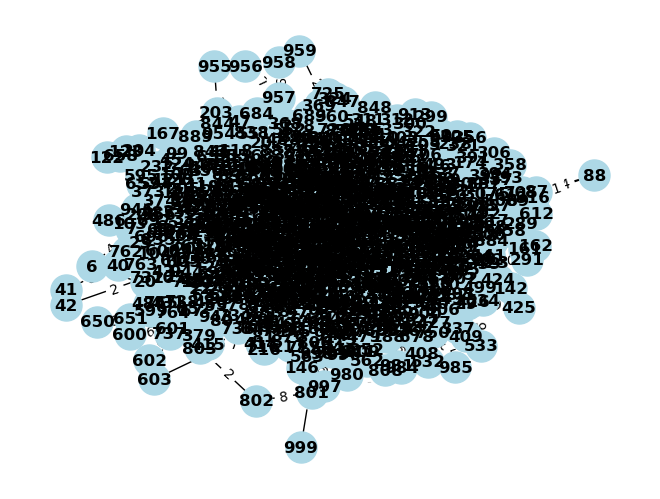

In [62]:
max_iterations = 7000

# Pré-calculer les chemins de Dijkstra pour toutes les paires de nœuds
all_paths = dict(nx.all_pairs_dijkstra_path(G, weight='distance'))

# Calculer les plus courts chemins entre toutes les paires de nœuds
path_lengths = dict(nx.all_pairs_dijkstra_path_length(G, weight='distance'))

# Exécuter le recuit simulé pour chaque camion en parallèle
results = []
with concurrent.futures.ThreadPoolExecutor() as executor:
    futures = [executor.submit(optimize_path, points) for points in truck_assignments]
    results = [f.result() for f in futures]

# Extraire les résultats
all_paths, total_distances, all_iterations_data, times, memory_usages = zip(*results)

for i, (optimal_path, total_distance, iteration_data, exec_time, mem_usage) in enumerate(results):
    print(f"\nPoints de passage pour le camion {i + 1} : {truck_assignments[i]}")
    print(f"Chemin optimal pour le camion {i + 1} : {optimal_path}")
    print(f"Distance totale du chemin pour le camion {i + 1} : {total_distance} km")
    print(f"Temps de calcul : {exec_time:.4f} secondes")
    print(f"Utilisation de la mémoire : {mem_usage:.2f} Ko")

# Afficher le graphe avec les chemins optimaux
draw_weighted_graph(G, all_paths)

In [ ]:
# Graphiques des mesures de performance
plt.figure(figsize=(14, 7))

plt.subplot(1, 3, 1)
plt.plot(range(1, len(truck_assignments) + 1), times, marker='o')
plt.title('Temps de calcul par camion')
plt.xlabel('Camion')
plt.ylabel('Temps (s)')

plt.subplot(1, 3, 2)
plt.plot(range(1, len(truck_assignments) + 1), memory_usages, marker='o')
plt.title('Utilisation de la mémoire par camion')
plt.xlabel('Camion')
plt.ylabel('Mémoire (Ko)')

plt.subplot(1, 3, 3)
plt.plot(range(1, len(truck_assignments) + 1), total_distances, marker='o')
plt.title('Distance totale du chemin par camion')
plt.xlabel('Camion')
plt.ylabel('Distance totale (km)')

plt.tight_layout()
plt.show()

# Graphiques des itérations et des solutions
for i, iteration_data in enumerate(all_iterations_data):
    iterations, current_distances, best_distances = zip(*iteration_data)
    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(iterations, current_distances, marker='o', label='Distance actuelle')
    plt.plot(iterations, best_distances, marker='x', label='Meilleure distance')
    plt.title(f'Évolution de la distance - Camion {i + 1}')
    plt.xlabel('Itération')
    plt.ylabel('Distance (km)')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(best_distances, marker='x')
    plt.title(f'Meilleures solutions trouvées - Camion {i + 1}')
    plt.xlabel('Index de la solution')
    plt.ylabel('Distance (km)')

    plt.tight_layout()
    plt.show()

# Calcul de la moyenne et de l'écart type de la distance totale des chemins optimaux pris par les camions
total_distance_mean = round(np.mean(total_distances),2)
total_distance_std = round(np.std(total_distances),2)

# Calcul du temps total pris pour trouver les chemins optimaux
total_time_taken = round(sum(times),2)

# Affichage des statistiques
print("\nStatistiques:")
print(f"Moyenne de la distance totale des chemins optimaux : {total_distance_mean} km")
print(f"Écart type de la distance totale des chemins optimaux : {total_distance_std} km")
print(f"Temps total pris pour trouver les chemins optimaux : {total_time_taken} secondes")

# Graphique pour la distance totale des chemins optimaux par camion
plt.figure(figsize=(8, 6))
plt.bar(range(len(truck_assignments)), total_distances)
plt.xlabel('Camion')
plt.ylabel('Distance totale du chemin')
plt.title('Distance totale des chemins optimaux par camion')
plt.show()

#### On peut voir que le moyenne de la distance à augmenter (37km -> 43km)
#### Le temps d'exécution a aussi fortement augemnté (6sec -> 205 sec)
#### Seul l'écart type a diminuer, ce qui veut dire que les résultats sont plus proches de la moyenne et sont donc plus précis. 

#### Pour conclure, on peut voir que le nombre d'itérations ainsi que le nombre de colis a un impact sur la solution finale, en bien comme en mal. 
#### Pour avoir la tournée la plus écologique possible, il faut donc trouver le bon compromis entre nombre d'itérations et nombre de colis dans les camions pour avoir la solution la plus optimale et la plus écologique possible. 